# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory 'data': File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

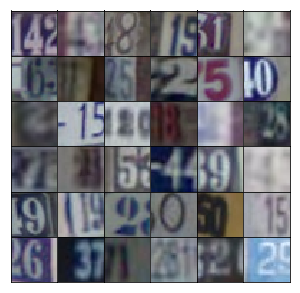

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        l1 = tf.layers.dense(z, 4*4*512, activation=None)
        l1 = tf.reshape(l1, (-1, 4, 4, 512))
        l1 = tf.layers.batch_normalization(l1, training=training)
        l1 = tf.maximum(alpha*l1, l1)
        # (batch, 4, 4, 512)
        
        l2 = tf.layers.conv2d_transpose(l1, 256, kernel_size=3, strides=2, padding="same")
        l2 = tf.layers.batch_normalization(l2, training=training)
        l2 = tf.maximum(alpha*l2, l2)
        # (batch, 8, 8, 256)
        
        l3 = tf.layers.conv2d_transpose(l2, 128, kernel_size=3, strides=2, padding="same")
        l3 = tf.layers.batch_normalization(l3, training=training)
        l3 = tf.maximum(alpha*l3, l3)
        # (batch, 16, 16, 128)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(l3, output_dim, kernel_size=3, strides=2, padding="same")
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        l1 = tf.layers.conv2d(x, 64, kernel_size=3, strides=2, padding="same")
        l1 = tf.maximum(alpha * l1, l1)
        # (16, 16, 64)
        
        l2 = tf.layers.conv2d(l1, 128, kernel_size=3, strides=2, padding="same")
        l2 = tf.layers.batch_normalization(l2, training=True)
        l2 = tf.maximum(alpha * l2, l2)
        # (8, 8, 128)
        
        l3 = tf.layers.conv2d(l2, 256, kernel_size=3, strides=2, padding="same")
        l3 = tf.layers.batch_normalization(l3, training=True)
        l3 = tf.maximum(alpha * l3, l3)
        # (4, 4, 256)
        
        flat = tf.reshape(l3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1, activation=None)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [25]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.001
batch_size = 128
epochs = 20
alpha = 0.2
beta1 = 0.5


# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/20... Discriminator Loss: 0.5644... Generator Loss: 2.0947
Epoch 1/20... Discriminator Loss: 0.2622... Generator Loss: 3.0863
Epoch 1/20... Discriminator Loss: 0.2757... Generator Loss: 2.0727
Epoch 1/20... Discriminator Loss: 1.2926... Generator Loss: 0.6120
Epoch 1/20... Discriminator Loss: 0.7817... Generator Loss: 1.8769
Epoch 1/20... Discriminator Loss: 0.6135... Generator Loss: 1.5768
Epoch 1/20... Discriminator Loss: 1.0473... Generator Loss: 1.1195
Epoch 1/20... Discriminator Loss: 0.5111... Generator Loss: 1.2271
Epoch 1/20... Discriminator Loss: 1.3478... Generator Loss: 3.1997
Epoch 1/20... Discriminator Loss: 0.6005... Generator Loss: 1.1231


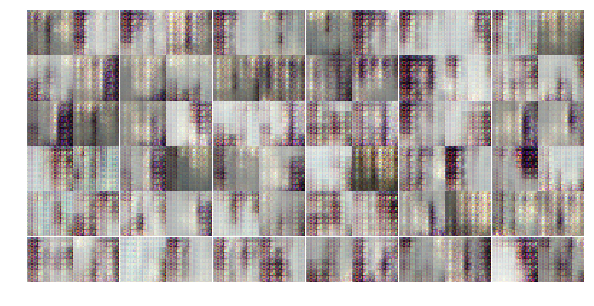

Epoch 1/20... Discriminator Loss: 0.9392... Generator Loss: 1.2413
Epoch 1/20... Discriminator Loss: 0.5922... Generator Loss: 1.4559
Epoch 1/20... Discriminator Loss: 0.3759... Generator Loss: 2.0470
Epoch 1/20... Discriminator Loss: 0.8126... Generator Loss: 1.6708
Epoch 1/20... Discriminator Loss: 1.3082... Generator Loss: 0.5314
Epoch 1/20... Discriminator Loss: 0.4449... Generator Loss: 1.7990
Epoch 1/20... Discriminator Loss: 1.6281... Generator Loss: 0.9663
Epoch 1/20... Discriminator Loss: 0.6438... Generator Loss: 2.8016
Epoch 1/20... Discriminator Loss: 1.0998... Generator Loss: 1.2280
Epoch 1/20... Discriminator Loss: 1.1095... Generator Loss: 0.8883


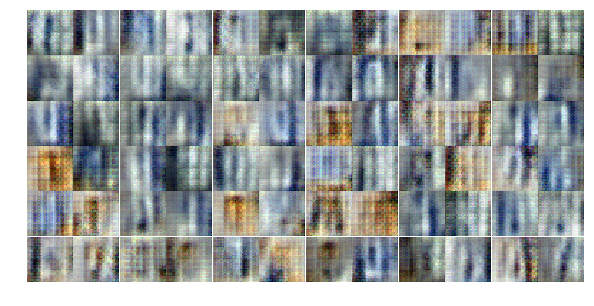

Epoch 1/20... Discriminator Loss: 0.9387... Generator Loss: 2.6659
Epoch 1/20... Discriminator Loss: 1.4208... Generator Loss: 2.8874
Epoch 1/20... Discriminator Loss: 1.6886... Generator Loss: 0.3100
Epoch 1/20... Discriminator Loss: 0.8593... Generator Loss: 0.7428
Epoch 1/20... Discriminator Loss: 0.5936... Generator Loss: 1.1654
Epoch 1/20... Discriminator Loss: 1.6953... Generator Loss: 0.7413
Epoch 1/20... Discriminator Loss: 0.8944... Generator Loss: 0.9058
Epoch 1/20... Discriminator Loss: 1.1635... Generator Loss: 1.0443
Epoch 1/20... Discriminator Loss: 1.0388... Generator Loss: 1.4404
Epoch 1/20... Discriminator Loss: 0.9829... Generator Loss: 1.3658


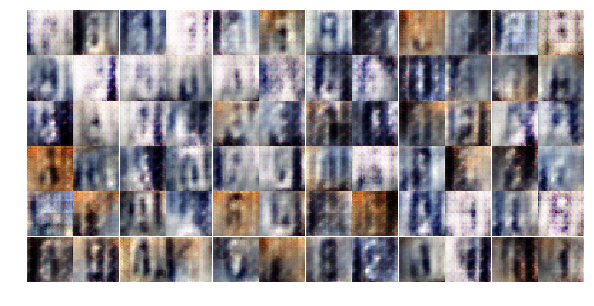

Epoch 1/20... Discriminator Loss: 1.0836... Generator Loss: 0.7864
Epoch 1/20... Discriminator Loss: 0.9250... Generator Loss: 2.1925
Epoch 1/20... Discriminator Loss: 0.4174... Generator Loss: 2.2778
Epoch 1/20... Discriminator Loss: 1.3862... Generator Loss: 0.4167
Epoch 1/20... Discriminator Loss: 1.8018... Generator Loss: 2.0374
Epoch 1/20... Discriminator Loss: 0.3465... Generator Loss: 2.0495
Epoch 1/20... Discriminator Loss: 1.2761... Generator Loss: 0.4696
Epoch 1/20... Discriminator Loss: 0.7320... Generator Loss: 1.2373
Epoch 1/20... Discriminator Loss: 1.1035... Generator Loss: 0.7574
Epoch 1/20... Discriminator Loss: 0.6101... Generator Loss: 2.7357


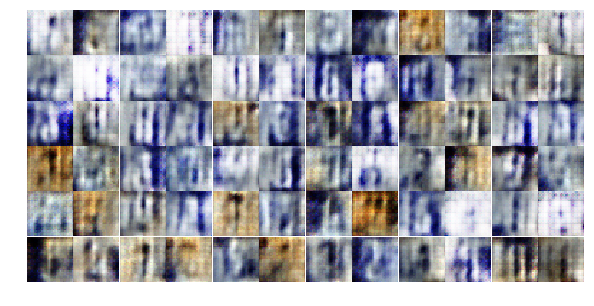

Epoch 1/20... Discriminator Loss: 1.1192... Generator Loss: 0.7161
Epoch 1/20... Discriminator Loss: 2.1400... Generator Loss: 0.1507
Epoch 1/20... Discriminator Loss: 0.3332... Generator Loss: 2.0916
Epoch 1/20... Discriminator Loss: 1.4275... Generator Loss: 0.3755
Epoch 1/20... Discriminator Loss: 1.7396... Generator Loss: 0.3281
Epoch 1/20... Discriminator Loss: 0.3460... Generator Loss: 2.7444
Epoch 1/20... Discriminator Loss: 5.7897... Generator Loss: 6.6408
Epoch 1/20... Discriminator Loss: 0.6173... Generator Loss: 1.1036
Epoch 1/20... Discriminator Loss: 0.4632... Generator Loss: 3.1183
Epoch 1/20... Discriminator Loss: 1.5249... Generator Loss: 0.3732


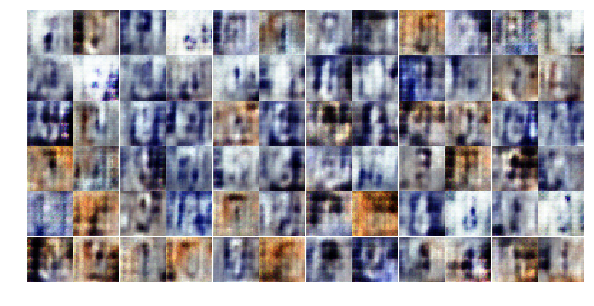

Epoch 1/20... Discriminator Loss: 0.3302... Generator Loss: 2.0782
Epoch 1/20... Discriminator Loss: 0.2043... Generator Loss: 2.0746
Epoch 1/20... Discriminator Loss: 0.3281... Generator Loss: 1.7316
Epoch 1/20... Discriminator Loss: 1.5314... Generator Loss: 0.3537
Epoch 1/20... Discriminator Loss: 2.1417... Generator Loss: 2.2559
Epoch 1/20... Discriminator Loss: 1.3891... Generator Loss: 3.0263
Epoch 1/20... Discriminator Loss: 0.6120... Generator Loss: 1.3995
Epoch 2/20... Discriminator Loss: 0.8991... Generator Loss: 0.6731
Epoch 2/20... Discriminator Loss: 0.2613... Generator Loss: 2.2055
Epoch 2/20... Discriminator Loss: 1.5485... Generator Loss: 0.3040


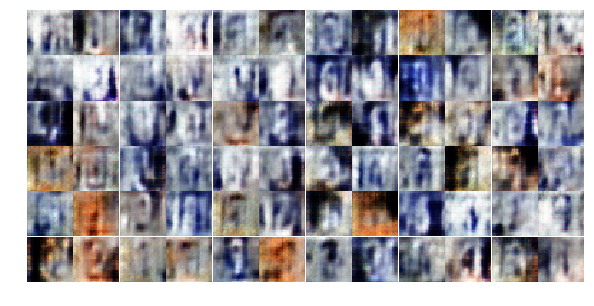

Epoch 2/20... Discriminator Loss: 1.2558... Generator Loss: 0.4777
Epoch 2/20... Discriminator Loss: 0.6458... Generator Loss: 3.3594
Epoch 2/20... Discriminator Loss: 2.0789... Generator Loss: 0.1730
Epoch 2/20... Discriminator Loss: 0.5382... Generator Loss: 1.2214
Epoch 2/20... Discriminator Loss: 0.3455... Generator Loss: 1.6749
Epoch 2/20... Discriminator Loss: 1.0653... Generator Loss: 5.2846
Epoch 2/20... Discriminator Loss: 0.8254... Generator Loss: 4.1989
Epoch 2/20... Discriminator Loss: 0.7200... Generator Loss: 1.0397
Epoch 2/20... Discriminator Loss: 0.1708... Generator Loss: 3.7036
Epoch 2/20... Discriminator Loss: 0.1495... Generator Loss: 3.5497


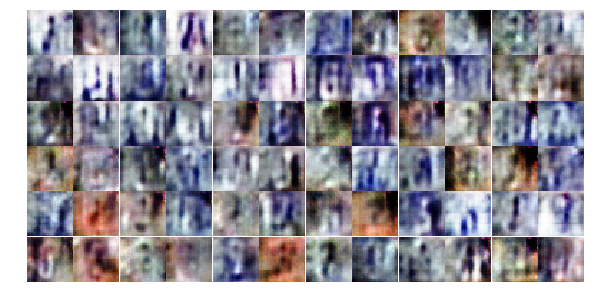

Epoch 2/20... Discriminator Loss: 0.4057... Generator Loss: 2.3993
Epoch 2/20... Discriminator Loss: 0.6857... Generator Loss: 3.2953
Epoch 2/20... Discriminator Loss: 0.8542... Generator Loss: 3.7548
Epoch 2/20... Discriminator Loss: 0.4724... Generator Loss: 2.1922
Epoch 2/20... Discriminator Loss: 0.8751... Generator Loss: 0.8847
Epoch 2/20... Discriminator Loss: 1.1613... Generator Loss: 1.1209
Epoch 2/20... Discriminator Loss: 0.7066... Generator Loss: 1.1149
Epoch 2/20... Discriminator Loss: 0.8708... Generator Loss: 1.2944
Epoch 2/20... Discriminator Loss: 1.0319... Generator Loss: 1.0438
Epoch 2/20... Discriminator Loss: 0.9990... Generator Loss: 1.2378


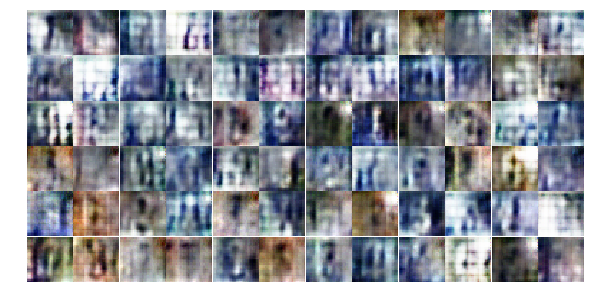

Epoch 2/20... Discriminator Loss: 1.4506... Generator Loss: 0.5469
Epoch 2/20... Discriminator Loss: 0.8012... Generator Loss: 0.9021
Epoch 2/20... Discriminator Loss: 0.8138... Generator Loss: 0.9110
Epoch 2/20... Discriminator Loss: 0.3454... Generator Loss: 1.8642
Epoch 2/20... Discriminator Loss: 0.5964... Generator Loss: 1.8996
Epoch 2/20... Discriminator Loss: 0.8680... Generator Loss: 1.3161
Epoch 2/20... Discriminator Loss: 0.6778... Generator Loss: 1.1531
Epoch 2/20... Discriminator Loss: 0.7554... Generator Loss: 1.3995
Epoch 2/20... Discriminator Loss: 0.6631... Generator Loss: 1.3979
Epoch 2/20... Discriminator Loss: 0.6528... Generator Loss: 2.4194


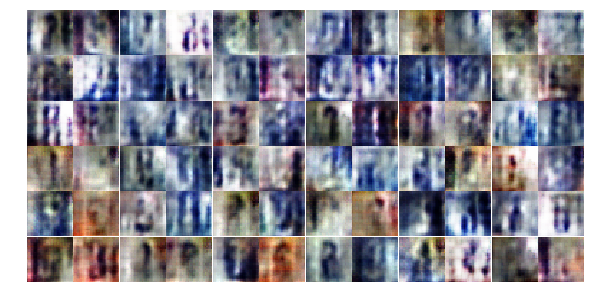

Epoch 2/20... Discriminator Loss: 1.0952... Generator Loss: 0.6416
Epoch 2/20... Discriminator Loss: 1.0360... Generator Loss: 1.5656
Epoch 2/20... Discriminator Loss: 0.3359... Generator Loss: 2.6069
Epoch 2/20... Discriminator Loss: 0.6947... Generator Loss: 0.9931
Epoch 2/20... Discriminator Loss: 0.4871... Generator Loss: 1.8069
Epoch 2/20... Discriminator Loss: 0.5539... Generator Loss: 2.5100
Epoch 2/20... Discriminator Loss: 1.3501... Generator Loss: 1.5627
Epoch 2/20... Discriminator Loss: 0.9287... Generator Loss: 2.8707
Epoch 2/20... Discriminator Loss: 1.0340... Generator Loss: 0.6624
Epoch 2/20... Discriminator Loss: 1.3766... Generator Loss: 0.4727


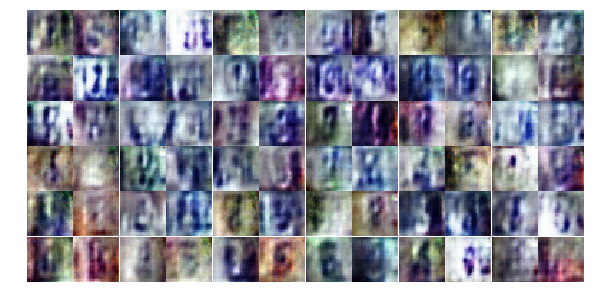

Epoch 2/20... Discriminator Loss: 0.5091... Generator Loss: 1.8873
Epoch 2/20... Discriminator Loss: 0.4639... Generator Loss: 1.8308
Epoch 2/20... Discriminator Loss: 0.5637... Generator Loss: 1.7715
Epoch 2/20... Discriminator Loss: 3.1229... Generator Loss: 3.6114
Epoch 2/20... Discriminator Loss: 1.0345... Generator Loss: 0.8768
Epoch 2/20... Discriminator Loss: 1.2294... Generator Loss: 0.6801
Epoch 2/20... Discriminator Loss: 1.0431... Generator Loss: 0.8718
Epoch 2/20... Discriminator Loss: 0.8088... Generator Loss: 2.3765
Epoch 2/20... Discriminator Loss: 0.4324... Generator Loss: 3.2935
Epoch 2/20... Discriminator Loss: 0.2461... Generator Loss: 3.1478


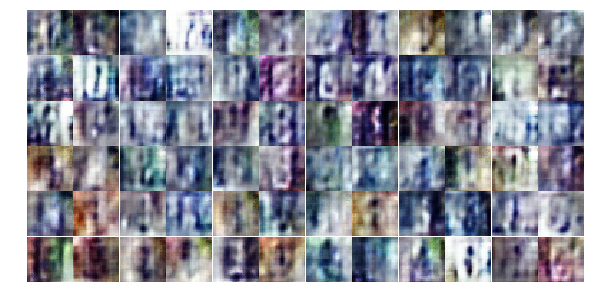

Epoch 2/20... Discriminator Loss: 0.8472... Generator Loss: 1.5367
Epoch 2/20... Discriminator Loss: 0.6315... Generator Loss: 2.6610
Epoch 2/20... Discriminator Loss: 0.6328... Generator Loss: 1.9367
Epoch 2/20... Discriminator Loss: 0.5691... Generator Loss: 1.7092
Epoch 3/20... Discriminator Loss: 0.4208... Generator Loss: 2.3898
Epoch 3/20... Discriminator Loss: 0.6964... Generator Loss: 1.4938
Epoch 3/20... Discriminator Loss: 0.2666... Generator Loss: 4.9907
Epoch 3/20... Discriminator Loss: 0.4617... Generator Loss: 1.6072
Epoch 3/20... Discriminator Loss: 0.7586... Generator Loss: 1.3387
Epoch 3/20... Discriminator Loss: 0.8977... Generator Loss: 0.9029


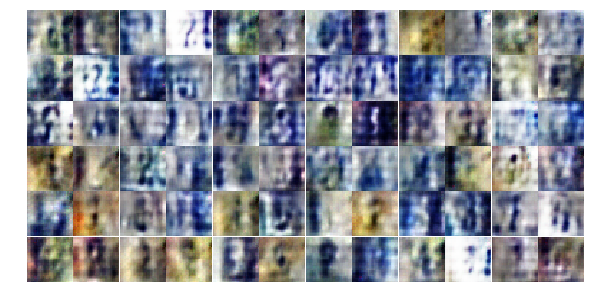

Epoch 3/20... Discriminator Loss: 1.6549... Generator Loss: 3.0008
Epoch 3/20... Discriminator Loss: 0.3346... Generator Loss: 4.1105
Epoch 3/20... Discriminator Loss: 1.0920... Generator Loss: 0.5973
Epoch 3/20... Discriminator Loss: 0.6055... Generator Loss: 2.0857
Epoch 3/20... Discriminator Loss: 0.7307... Generator Loss: 3.0284
Epoch 3/20... Discriminator Loss: 1.1970... Generator Loss: 2.6259
Epoch 3/20... Discriminator Loss: 0.7146... Generator Loss: 2.5897
Epoch 3/20... Discriminator Loss: 1.1839... Generator Loss: 0.7731
Epoch 3/20... Discriminator Loss: 0.8947... Generator Loss: 0.8235
Epoch 3/20... Discriminator Loss: 0.6970... Generator Loss: 1.6369


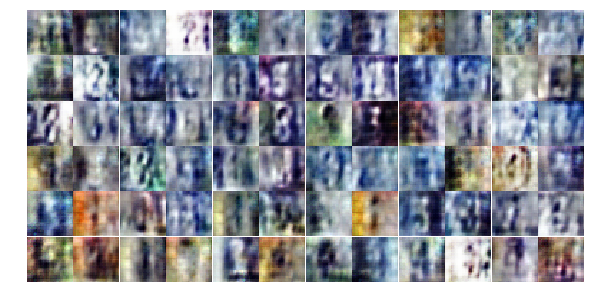

Epoch 3/20... Discriminator Loss: 0.9840... Generator Loss: 0.7284
Epoch 3/20... Discriminator Loss: 0.8376... Generator Loss: 0.8052
Epoch 3/20... Discriminator Loss: 0.7139... Generator Loss: 1.7501
Epoch 3/20... Discriminator Loss: 1.2580... Generator Loss: 0.5330
Epoch 3/20... Discriminator Loss: 0.3941... Generator Loss: 2.3249
Epoch 3/20... Discriminator Loss: 0.8079... Generator Loss: 1.4792
Epoch 3/20... Discriminator Loss: 0.5522... Generator Loss: 1.5060
Epoch 3/20... Discriminator Loss: 1.5771... Generator Loss: 0.3714
Epoch 3/20... Discriminator Loss: 0.5022... Generator Loss: 1.8940
Epoch 3/20... Discriminator Loss: 1.3219... Generator Loss: 0.4802


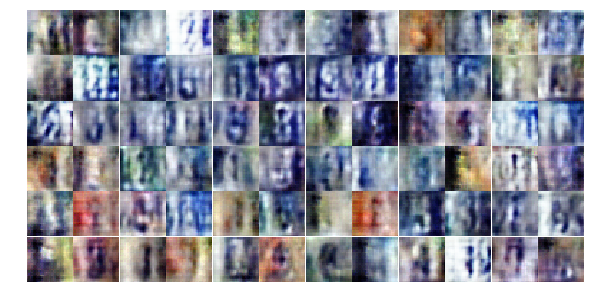

Epoch 3/20... Discriminator Loss: 1.0954... Generator Loss: 2.7504
Epoch 3/20... Discriminator Loss: 0.7570... Generator Loss: 1.6735
Epoch 3/20... Discriminator Loss: 2.2923... Generator Loss: 3.5246
Epoch 3/20... Discriminator Loss: 0.7936... Generator Loss: 2.9168
Epoch 3/20... Discriminator Loss: 0.9066... Generator Loss: 1.3684
Epoch 3/20... Discriminator Loss: 0.7444... Generator Loss: 0.9807
Epoch 3/20... Discriminator Loss: 0.4605... Generator Loss: 2.1085
Epoch 3/20... Discriminator Loss: 1.3229... Generator Loss: 0.6029
Epoch 3/20... Discriminator Loss: 1.2211... Generator Loss: 0.8507
Epoch 3/20... Discriminator Loss: 1.2396... Generator Loss: 0.5477


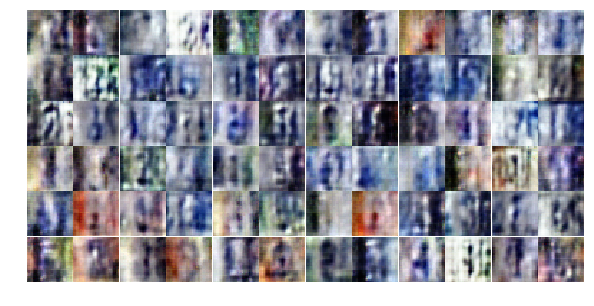

Epoch 3/20... Discriminator Loss: 0.8273... Generator Loss: 1.4572
Epoch 3/20... Discriminator Loss: 1.7123... Generator Loss: 0.2885
Epoch 3/20... Discriminator Loss: 0.9358... Generator Loss: 1.0778
Epoch 3/20... Discriminator Loss: 0.7023... Generator Loss: 1.7794
Epoch 3/20... Discriminator Loss: 0.6239... Generator Loss: 1.2366
Epoch 3/20... Discriminator Loss: 1.0625... Generator Loss: 2.7831
Epoch 3/20... Discriminator Loss: 1.2416... Generator Loss: 0.5113
Epoch 3/20... Discriminator Loss: 1.0213... Generator Loss: 0.9811
Epoch 3/20... Discriminator Loss: 1.1058... Generator Loss: 1.4368
Epoch 3/20... Discriminator Loss: 0.8496... Generator Loss: 1.8218


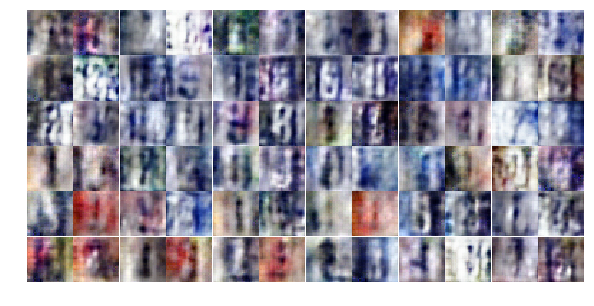

Epoch 3/20... Discriminator Loss: 1.1461... Generator Loss: 1.0870
Epoch 3/20... Discriminator Loss: 1.0538... Generator Loss: 1.1253
Epoch 3/20... Discriminator Loss: 1.1553... Generator Loss: 0.5843
Epoch 3/20... Discriminator Loss: 0.6806... Generator Loss: 1.3035
Epoch 3/20... Discriminator Loss: 0.9354... Generator Loss: 1.2714
Epoch 3/20... Discriminator Loss: 1.4173... Generator Loss: 0.4069
Epoch 3/20... Discriminator Loss: 0.7072... Generator Loss: 2.1112
Epoch 3/20... Discriminator Loss: 0.5868... Generator Loss: 1.3144
Epoch 3/20... Discriminator Loss: 0.7777... Generator Loss: 1.0674
Epoch 3/20... Discriminator Loss: 1.1067... Generator Loss: 0.7298


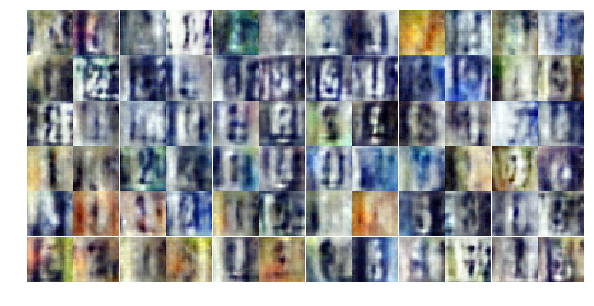

Epoch 3/20... Discriminator Loss: 2.0587... Generator Loss: 0.1811
Epoch 4/20... Discriminator Loss: 0.9617... Generator Loss: 1.6815
Epoch 4/20... Discriminator Loss: 0.6806... Generator Loss: 1.5392
Epoch 4/20... Discriminator Loss: 0.9720... Generator Loss: 0.8541
Epoch 4/20... Discriminator Loss: 0.9005... Generator Loss: 1.0380
Epoch 4/20... Discriminator Loss: 0.9427... Generator Loss: 1.0186
Epoch 4/20... Discriminator Loss: 0.7675... Generator Loss: 1.3487
Epoch 4/20... Discriminator Loss: 1.6385... Generator Loss: 0.2998
Epoch 4/20... Discriminator Loss: 0.7564... Generator Loss: 1.9400
Epoch 4/20... Discriminator Loss: 0.6861... Generator Loss: 1.2186


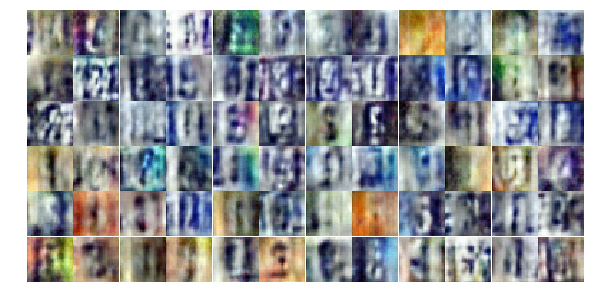

Epoch 4/20... Discriminator Loss: 0.4309... Generator Loss: 1.9948
Epoch 4/20... Discriminator Loss: 1.1467... Generator Loss: 1.4820
Epoch 4/20... Discriminator Loss: 0.7620... Generator Loss: 1.2899
Epoch 4/20... Discriminator Loss: 1.0293... Generator Loss: 0.7866
Epoch 4/20... Discriminator Loss: 1.0919... Generator Loss: 0.8722
Epoch 4/20... Discriminator Loss: 1.4614... Generator Loss: 0.5445
Epoch 4/20... Discriminator Loss: 1.7223... Generator Loss: 0.3186
Epoch 4/20... Discriminator Loss: 0.9887... Generator Loss: 0.8037
Epoch 4/20... Discriminator Loss: 1.1169... Generator Loss: 0.7541
Epoch 4/20... Discriminator Loss: 0.6789... Generator Loss: 1.7147


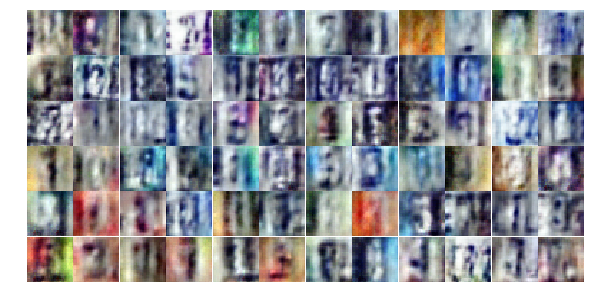

Epoch 4/20... Discriminator Loss: 0.9417... Generator Loss: 0.7586
Epoch 4/20... Discriminator Loss: 1.0721... Generator Loss: 1.2559
Epoch 4/20... Discriminator Loss: 1.1064... Generator Loss: 0.9171
Epoch 4/20... Discriminator Loss: 1.0791... Generator Loss: 0.6367
Epoch 4/20... Discriminator Loss: 1.2001... Generator Loss: 1.1917
Epoch 4/20... Discriminator Loss: 0.7263... Generator Loss: 1.4718
Epoch 4/20... Discriminator Loss: 0.7946... Generator Loss: 1.3210
Epoch 4/20... Discriminator Loss: 0.8407... Generator Loss: 1.2714
Epoch 4/20... Discriminator Loss: 0.5503... Generator Loss: 1.8176
Epoch 4/20... Discriminator Loss: 1.0839... Generator Loss: 1.0146


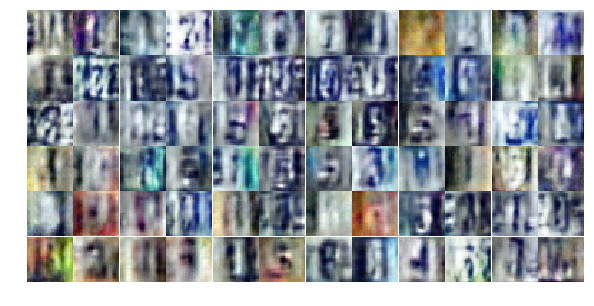

Epoch 4/20... Discriminator Loss: 0.7259... Generator Loss: 1.2012
Epoch 4/20... Discriminator Loss: 1.1153... Generator Loss: 0.8099
Epoch 4/20... Discriminator Loss: 0.9183... Generator Loss: 1.0611
Epoch 4/20... Discriminator Loss: 0.8733... Generator Loss: 1.1615
Epoch 4/20... Discriminator Loss: 0.9586... Generator Loss: 2.1281
Epoch 4/20... Discriminator Loss: 0.9705... Generator Loss: 0.9761
Epoch 4/20... Discriminator Loss: 1.1836... Generator Loss: 1.1485
Epoch 4/20... Discriminator Loss: 0.9085... Generator Loss: 1.2258
Epoch 4/20... Discriminator Loss: 1.1606... Generator Loss: 0.5121
Epoch 4/20... Discriminator Loss: 0.9039... Generator Loss: 1.3524


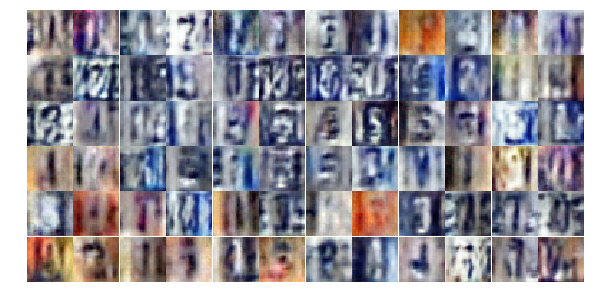

Epoch 4/20... Discriminator Loss: 1.0966... Generator Loss: 0.7406
Epoch 4/20... Discriminator Loss: 0.9610... Generator Loss: 0.8844
Epoch 4/20... Discriminator Loss: 0.9720... Generator Loss: 0.8609
Epoch 4/20... Discriminator Loss: 1.2534... Generator Loss: 2.0530
Epoch 4/20... Discriminator Loss: 0.9227... Generator Loss: 0.9580
Epoch 4/20... Discriminator Loss: 0.5903... Generator Loss: 1.7818
Epoch 4/20... Discriminator Loss: 1.2424... Generator Loss: 0.4784
Epoch 4/20... Discriminator Loss: 1.3232... Generator Loss: 1.9422
Epoch 4/20... Discriminator Loss: 0.9712... Generator Loss: 0.7814
Epoch 4/20... Discriminator Loss: 0.8692... Generator Loss: 1.0807


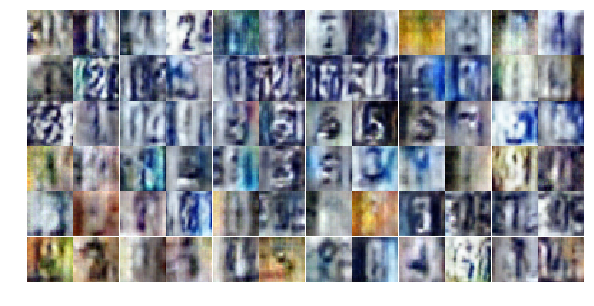

Epoch 4/20... Discriminator Loss: 1.0175... Generator Loss: 1.0176
Epoch 4/20... Discriminator Loss: 0.9022... Generator Loss: 0.8912
Epoch 4/20... Discriminator Loss: 0.9327... Generator Loss: 0.9102
Epoch 4/20... Discriminator Loss: 1.0447... Generator Loss: 0.8473
Epoch 4/20... Discriminator Loss: 0.8219... Generator Loss: 1.6075
Epoch 4/20... Discriminator Loss: 1.0255... Generator Loss: 1.1689
Epoch 4/20... Discriminator Loss: 1.0491... Generator Loss: 0.6935
Epoch 4/20... Discriminator Loss: 1.0855... Generator Loss: 1.0161
Epoch 4/20... Discriminator Loss: 0.9184... Generator Loss: 0.8685
Epoch 5/20... Discriminator Loss: 1.0054... Generator Loss: 1.1544


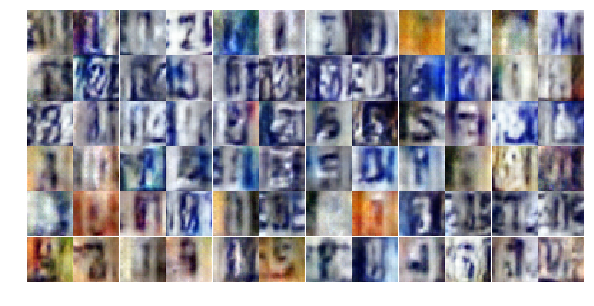

Epoch 5/20... Discriminator Loss: 1.0287... Generator Loss: 0.6941
Epoch 5/20... Discriminator Loss: 1.0164... Generator Loss: 0.7744
Epoch 5/20... Discriminator Loss: 1.3006... Generator Loss: 0.4894
Epoch 5/20... Discriminator Loss: 2.4765... Generator Loss: 0.1332
Epoch 5/20... Discriminator Loss: 0.9255... Generator Loss: 0.8958
Epoch 5/20... Discriminator Loss: 1.0460... Generator Loss: 0.7474
Epoch 5/20... Discriminator Loss: 0.9626... Generator Loss: 1.0001
Epoch 5/20... Discriminator Loss: 0.9789... Generator Loss: 0.9919
Epoch 5/20... Discriminator Loss: 1.3393... Generator Loss: 1.8596
Epoch 5/20... Discriminator Loss: 1.0885... Generator Loss: 0.7493


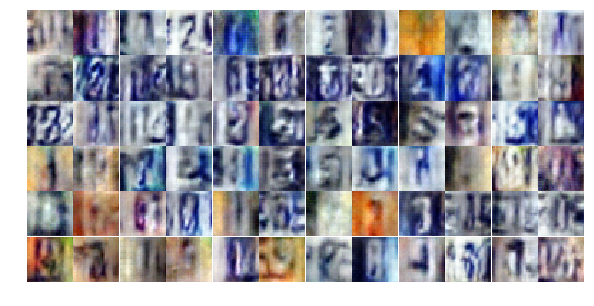

Epoch 5/20... Discriminator Loss: 1.2411... Generator Loss: 0.5217
Epoch 5/20... Discriminator Loss: 0.9346... Generator Loss: 1.3822
Epoch 5/20... Discriminator Loss: 0.8225... Generator Loss: 1.1710
Epoch 5/20... Discriminator Loss: 1.2843... Generator Loss: 0.5278
Epoch 5/20... Discriminator Loss: 1.2313... Generator Loss: 1.3871
Epoch 5/20... Discriminator Loss: 0.9860... Generator Loss: 0.8457
Epoch 5/20... Discriminator Loss: 1.3387... Generator Loss: 0.4683
Epoch 5/20... Discriminator Loss: 1.1436... Generator Loss: 0.5845
Epoch 5/20... Discriminator Loss: 1.3644... Generator Loss: 0.4158
Epoch 5/20... Discriminator Loss: 1.1033... Generator Loss: 0.6659


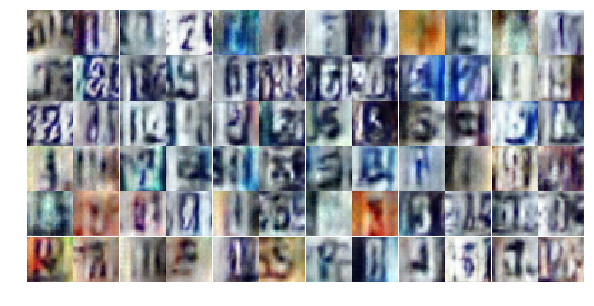

Epoch 5/20... Discriminator Loss: 1.1137... Generator Loss: 0.6078
Epoch 5/20... Discriminator Loss: 1.3314... Generator Loss: 0.5397
Epoch 5/20... Discriminator Loss: 1.0223... Generator Loss: 0.6928
Epoch 5/20... Discriminator Loss: 0.9267... Generator Loss: 1.0947
Epoch 5/20... Discriminator Loss: 1.2548... Generator Loss: 0.5459
Epoch 5/20... Discriminator Loss: 1.1126... Generator Loss: 0.8959
Epoch 5/20... Discriminator Loss: 1.3428... Generator Loss: 0.4836
Epoch 5/20... Discriminator Loss: 1.1126... Generator Loss: 0.7356
Epoch 5/20... Discriminator Loss: 1.0034... Generator Loss: 0.7548
Epoch 5/20... Discriminator Loss: 0.8236... Generator Loss: 1.0214


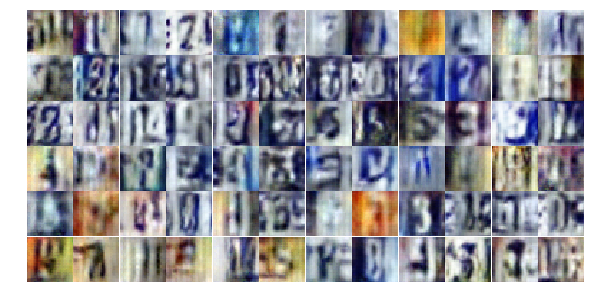

Epoch 5/20... Discriminator Loss: 1.2576... Generator Loss: 1.4553
Epoch 5/20... Discriminator Loss: 0.8695... Generator Loss: 1.0858
Epoch 5/20... Discriminator Loss: 0.9975... Generator Loss: 1.0983
Epoch 5/20... Discriminator Loss: 1.1491... Generator Loss: 0.6133
Epoch 5/20... Discriminator Loss: 1.0841... Generator Loss: 0.9186
Epoch 5/20... Discriminator Loss: 0.9500... Generator Loss: 1.1393
Epoch 5/20... Discriminator Loss: 1.1198... Generator Loss: 0.7836
Epoch 5/20... Discriminator Loss: 1.0291... Generator Loss: 0.7558
Epoch 5/20... Discriminator Loss: 1.5239... Generator Loss: 0.3233
Epoch 5/20... Discriminator Loss: 1.2850... Generator Loss: 0.4617


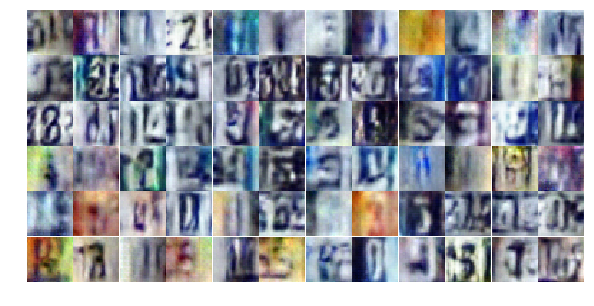

Epoch 5/20... Discriminator Loss: 0.9482... Generator Loss: 0.9766
Epoch 5/20... Discriminator Loss: 1.2291... Generator Loss: 0.6191
Epoch 5/20... Discriminator Loss: 1.1412... Generator Loss: 1.0514
Epoch 5/20... Discriminator Loss: 0.8593... Generator Loss: 1.6288
Epoch 5/20... Discriminator Loss: 1.8428... Generator Loss: 2.1810
Epoch 5/20... Discriminator Loss: 1.5916... Generator Loss: 0.3766
Epoch 5/20... Discriminator Loss: 0.9527... Generator Loss: 0.9630
Epoch 5/20... Discriminator Loss: 1.0780... Generator Loss: 0.6843
Epoch 5/20... Discriminator Loss: 1.1635... Generator Loss: 0.5495
Epoch 5/20... Discriminator Loss: 0.8443... Generator Loss: 1.0153


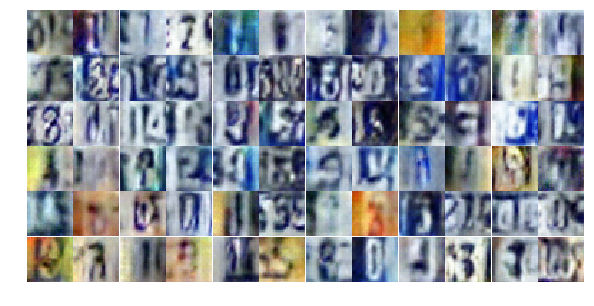

Epoch 5/20... Discriminator Loss: 1.0746... Generator Loss: 0.9466
Epoch 5/20... Discriminator Loss: 1.0143... Generator Loss: 1.0058
Epoch 5/20... Discriminator Loss: 1.0209... Generator Loss: 1.2076
Epoch 5/20... Discriminator Loss: 1.1204... Generator Loss: 0.5802
Epoch 5/20... Discriminator Loss: 1.0690... Generator Loss: 0.6487
Epoch 5/20... Discriminator Loss: 1.3661... Generator Loss: 0.4396
Epoch 6/20... Discriminator Loss: 1.0608... Generator Loss: 0.7817
Epoch 6/20... Discriminator Loss: 0.9401... Generator Loss: 0.8004
Epoch 6/20... Discriminator Loss: 1.3081... Generator Loss: 0.4552
Epoch 6/20... Discriminator Loss: 1.3334... Generator Loss: 0.4315


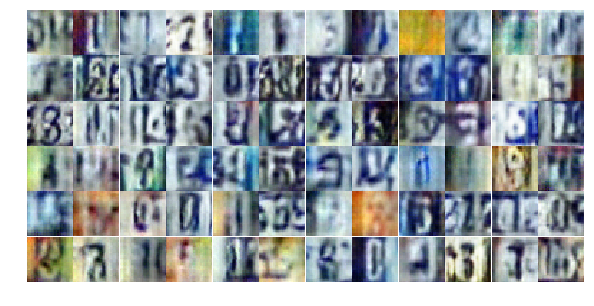

Epoch 6/20... Discriminator Loss: 1.0311... Generator Loss: 0.6066
Epoch 6/20... Discriminator Loss: 1.0051... Generator Loss: 0.7412
Epoch 6/20... Discriminator Loss: 1.6039... Generator Loss: 0.3429
Epoch 6/20... Discriminator Loss: 1.4501... Generator Loss: 0.4336
Epoch 6/20... Discriminator Loss: 0.9636... Generator Loss: 1.2257
Epoch 6/20... Discriminator Loss: 1.1642... Generator Loss: 0.5499
Epoch 6/20... Discriminator Loss: 0.7785... Generator Loss: 1.3706
Epoch 6/20... Discriminator Loss: 1.1183... Generator Loss: 0.5673
Epoch 6/20... Discriminator Loss: 1.2161... Generator Loss: 0.4976
Epoch 6/20... Discriminator Loss: 2.4578... Generator Loss: 0.1975


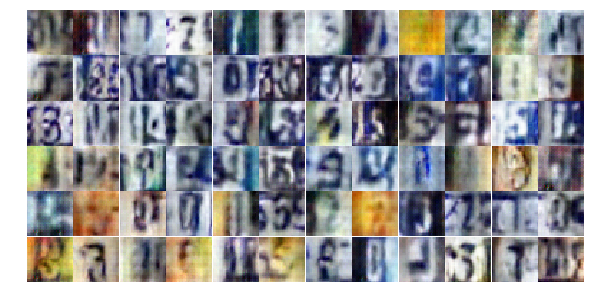

Epoch 6/20... Discriminator Loss: 1.4989... Generator Loss: 0.3804
Epoch 6/20... Discriminator Loss: 0.7345... Generator Loss: 1.5049
Epoch 6/20... Discriminator Loss: 0.9883... Generator Loss: 0.7939
Epoch 6/20... Discriminator Loss: 0.9062... Generator Loss: 1.0757
Epoch 6/20... Discriminator Loss: 0.7505... Generator Loss: 1.0972
Epoch 6/20... Discriminator Loss: 0.8311... Generator Loss: 1.1015
Epoch 6/20... Discriminator Loss: 1.0763... Generator Loss: 0.6431
Epoch 6/20... Discriminator Loss: 1.1241... Generator Loss: 0.6261
Epoch 6/20... Discriminator Loss: 1.0314... Generator Loss: 1.0666
Epoch 6/20... Discriminator Loss: 0.8651... Generator Loss: 0.9985


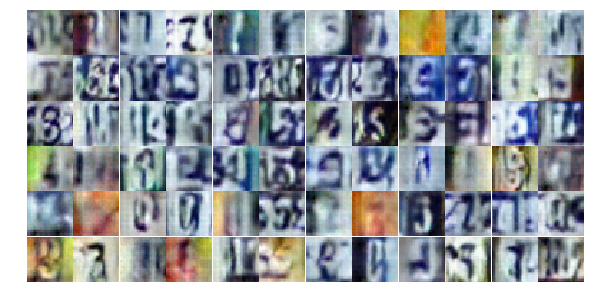

Epoch 6/20... Discriminator Loss: 0.7588... Generator Loss: 1.6058
Epoch 6/20... Discriminator Loss: 1.3083... Generator Loss: 0.4474
Epoch 6/20... Discriminator Loss: 2.0086... Generator Loss: 0.2453
Epoch 6/20... Discriminator Loss: 1.5012... Generator Loss: 0.4286
Epoch 6/20... Discriminator Loss: 1.0254... Generator Loss: 1.2577
Epoch 6/20... Discriminator Loss: 1.2223... Generator Loss: 0.5328
Epoch 6/20... Discriminator Loss: 1.2829... Generator Loss: 0.5697
Epoch 6/20... Discriminator Loss: 1.0135... Generator Loss: 0.9584
Epoch 6/20... Discriminator Loss: 1.0743... Generator Loss: 0.8648
Epoch 6/20... Discriminator Loss: 0.9918... Generator Loss: 0.8049


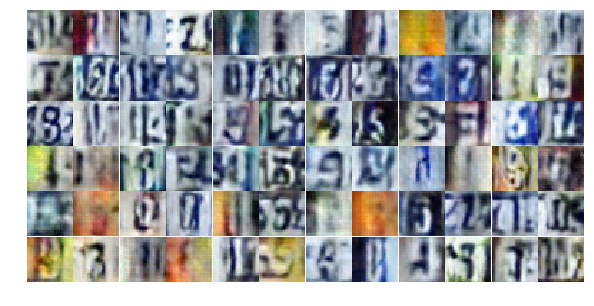

Epoch 6/20... Discriminator Loss: 1.0954... Generator Loss: 0.7757
Epoch 6/20... Discriminator Loss: 1.0927... Generator Loss: 0.9066
Epoch 6/20... Discriminator Loss: 0.9842... Generator Loss: 1.0327
Epoch 6/20... Discriminator Loss: 0.8547... Generator Loss: 1.1032
Epoch 6/20... Discriminator Loss: 0.9797... Generator Loss: 0.8135
Epoch 6/20... Discriminator Loss: 1.0889... Generator Loss: 0.6439
Epoch 6/20... Discriminator Loss: 0.9312... Generator Loss: 1.0870
Epoch 6/20... Discriminator Loss: 0.9042... Generator Loss: 1.2379
Epoch 6/20... Discriminator Loss: 1.4010... Generator Loss: 0.3748
Epoch 6/20... Discriminator Loss: 1.1031... Generator Loss: 0.5804


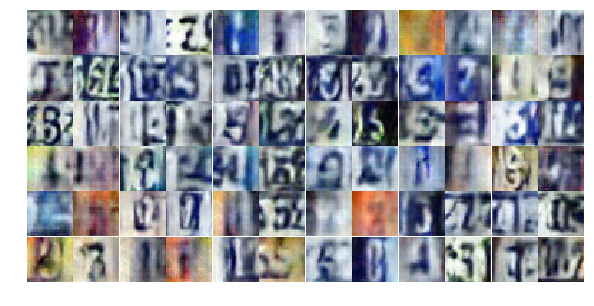

Epoch 6/20... Discriminator Loss: 1.4895... Generator Loss: 1.7683
Epoch 6/20... Discriminator Loss: 1.4818... Generator Loss: 0.4239
Epoch 6/20... Discriminator Loss: 1.8920... Generator Loss: 0.2543
Epoch 6/20... Discriminator Loss: 0.9693... Generator Loss: 1.4584
Epoch 6/20... Discriminator Loss: 0.9713... Generator Loss: 0.7763
Epoch 6/20... Discriminator Loss: 0.7257... Generator Loss: 1.3847
Epoch 6/20... Discriminator Loss: 1.1502... Generator Loss: 0.7144
Epoch 6/20... Discriminator Loss: 1.1212... Generator Loss: 0.6261
Epoch 6/20... Discriminator Loss: 1.0071... Generator Loss: 1.5558
Epoch 6/20... Discriminator Loss: 1.7073... Generator Loss: 0.2965


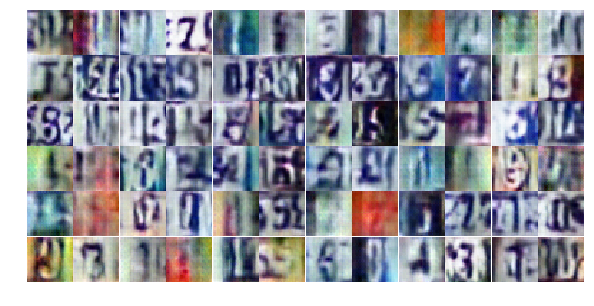

Epoch 6/20... Discriminator Loss: 1.0694... Generator Loss: 0.9463
Epoch 6/20... Discriminator Loss: 0.9183... Generator Loss: 0.8101
Epoch 6/20... Discriminator Loss: 0.9622... Generator Loss: 0.8627
Epoch 7/20... Discriminator Loss: 1.0021... Generator Loss: 0.9043
Epoch 7/20... Discriminator Loss: 0.9194... Generator Loss: 0.9187
Epoch 7/20... Discriminator Loss: 1.3284... Generator Loss: 1.4991
Epoch 7/20... Discriminator Loss: 1.0719... Generator Loss: 0.6264
Epoch 7/20... Discriminator Loss: 1.0887... Generator Loss: 0.5875
Epoch 7/20... Discriminator Loss: 0.7825... Generator Loss: 1.1337
Epoch 7/20... Discriminator Loss: 0.8534... Generator Loss: 1.0921


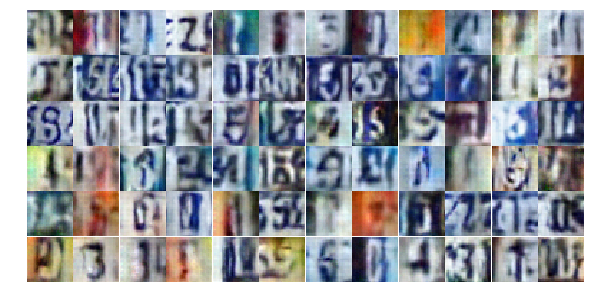

Epoch 7/20... Discriminator Loss: 0.9688... Generator Loss: 1.0145
Epoch 7/20... Discriminator Loss: 1.3769... Generator Loss: 0.4164
Epoch 7/20... Discriminator Loss: 1.3224... Generator Loss: 0.4191
Epoch 7/20... Discriminator Loss: 1.2589... Generator Loss: 0.6427
Epoch 7/20... Discriminator Loss: 0.8059... Generator Loss: 0.8962
Epoch 7/20... Discriminator Loss: 0.9310... Generator Loss: 0.8548
Epoch 7/20... Discriminator Loss: 1.6735... Generator Loss: 2.5878
Epoch 7/20... Discriminator Loss: 1.1916... Generator Loss: 0.8390
Epoch 7/20... Discriminator Loss: 1.0060... Generator Loss: 1.2641
Epoch 7/20... Discriminator Loss: 1.0771... Generator Loss: 1.2675


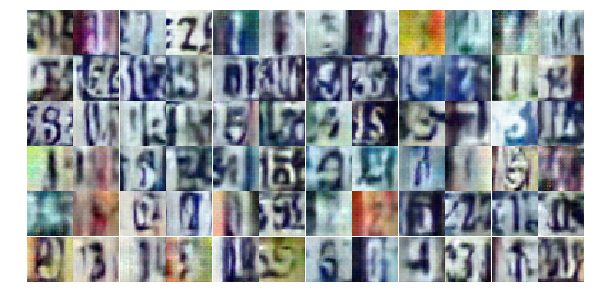

Epoch 7/20... Discriminator Loss: 1.2405... Generator Loss: 0.5128
Epoch 7/20... Discriminator Loss: 0.9516... Generator Loss: 1.1844
Epoch 7/20... Discriminator Loss: 1.1919... Generator Loss: 0.6269
Epoch 7/20... Discriminator Loss: 1.0538... Generator Loss: 0.9060
Epoch 7/20... Discriminator Loss: 0.9666... Generator Loss: 0.7744
Epoch 7/20... Discriminator Loss: 0.9345... Generator Loss: 1.1001
Epoch 7/20... Discriminator Loss: 0.8373... Generator Loss: 1.1698
Epoch 7/20... Discriminator Loss: 1.3488... Generator Loss: 0.5278
Epoch 7/20... Discriminator Loss: 0.9717... Generator Loss: 0.8283
Epoch 7/20... Discriminator Loss: 0.8606... Generator Loss: 2.2128


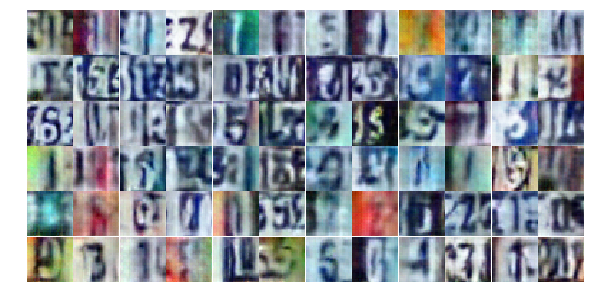

Epoch 7/20... Discriminator Loss: 1.4043... Generator Loss: 0.4904
Epoch 7/20... Discriminator Loss: 1.8491... Generator Loss: 0.2266
Epoch 7/20... Discriminator Loss: 1.1198... Generator Loss: 0.6039
Epoch 7/20... Discriminator Loss: 1.0945... Generator Loss: 0.6466
Epoch 7/20... Discriminator Loss: 0.8776... Generator Loss: 1.1083
Epoch 7/20... Discriminator Loss: 1.1912... Generator Loss: 0.5553
Epoch 7/20... Discriminator Loss: 1.0357... Generator Loss: 0.9518
Epoch 7/20... Discriminator Loss: 0.9402... Generator Loss: 1.1211
Epoch 7/20... Discriminator Loss: 1.7524... Generator Loss: 0.2693
Epoch 7/20... Discriminator Loss: 1.0146... Generator Loss: 1.8066


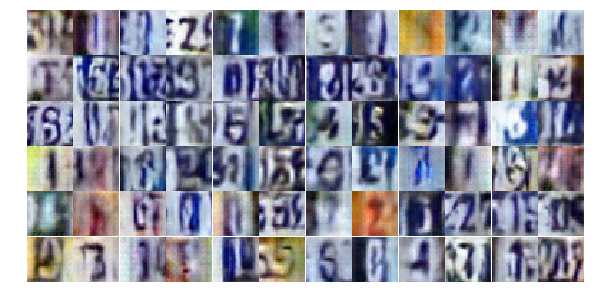

Epoch 7/20... Discriminator Loss: 1.4158... Generator Loss: 0.4143
Epoch 7/20... Discriminator Loss: 1.2690... Generator Loss: 0.5495
Epoch 7/20... Discriminator Loss: 0.9837... Generator Loss: 0.8777
Epoch 7/20... Discriminator Loss: 0.8726... Generator Loss: 0.9960
Epoch 7/20... Discriminator Loss: 0.6641... Generator Loss: 1.2346
Epoch 7/20... Discriminator Loss: 0.6450... Generator Loss: 1.4425
Epoch 7/20... Discriminator Loss: 1.0437... Generator Loss: 0.7006
Epoch 7/20... Discriminator Loss: 1.9003... Generator Loss: 0.2394
Epoch 7/20... Discriminator Loss: 1.0017... Generator Loss: 3.2526
Epoch 7/20... Discriminator Loss: 2.1275... Generator Loss: 1.5521


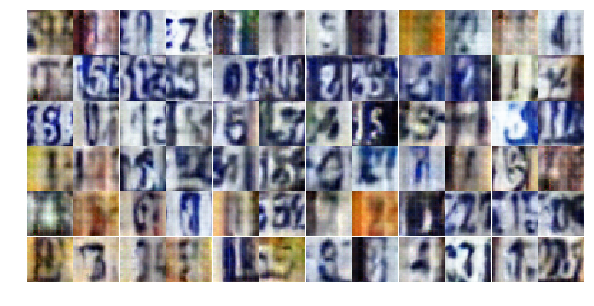

Epoch 7/20... Discriminator Loss: 1.0257... Generator Loss: 0.8403
Epoch 7/20... Discriminator Loss: 0.8671... Generator Loss: 1.0309
Epoch 7/20... Discriminator Loss: 1.2261... Generator Loss: 0.7219
Epoch 7/20... Discriminator Loss: 1.0512... Generator Loss: 0.6548
Epoch 7/20... Discriminator Loss: 1.1192... Generator Loss: 0.9015
Epoch 7/20... Discriminator Loss: 1.0864... Generator Loss: 0.6028
Epoch 7/20... Discriminator Loss: 1.4976... Generator Loss: 0.3506
Epoch 7/20... Discriminator Loss: 1.2788... Generator Loss: 0.4990
Epoch 7/20... Discriminator Loss: 1.0762... Generator Loss: 0.6444
Epoch 7/20... Discriminator Loss: 0.8744... Generator Loss: 0.9507


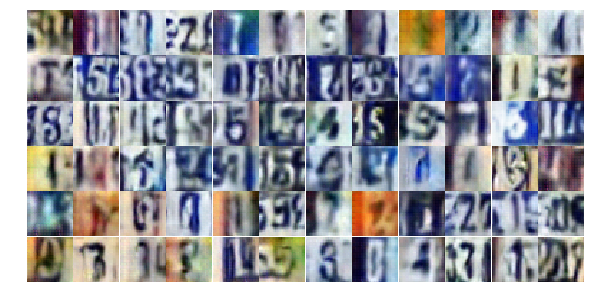

Epoch 7/20... Discriminator Loss: 0.9155... Generator Loss: 0.9263
Epoch 8/20... Discriminator Loss: 1.0603... Generator Loss: 0.9475
Epoch 8/20... Discriminator Loss: 1.2926... Generator Loss: 0.4461
Epoch 8/20... Discriminator Loss: 1.0627... Generator Loss: 0.7173
Epoch 8/20... Discriminator Loss: 1.0832... Generator Loss: 0.7961
Epoch 8/20... Discriminator Loss: 1.0156... Generator Loss: 0.9213
Epoch 8/20... Discriminator Loss: 1.0352... Generator Loss: 0.6751
Epoch 8/20... Discriminator Loss: 0.9493... Generator Loss: 0.9484
Epoch 8/20... Discriminator Loss: 1.3967... Generator Loss: 0.4141
Epoch 8/20... Discriminator Loss: 1.1987... Generator Loss: 0.5306


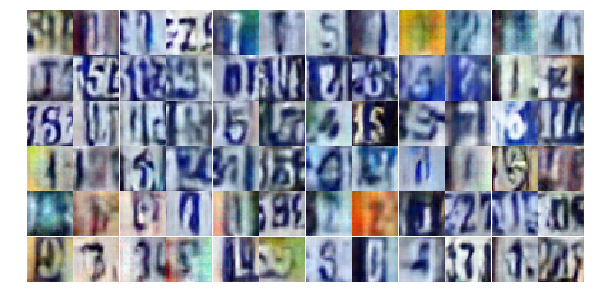

Epoch 8/20... Discriminator Loss: 0.7866... Generator Loss: 1.1835
Epoch 8/20... Discriminator Loss: 1.0738... Generator Loss: 0.9286
Epoch 8/20... Discriminator Loss: 1.0728... Generator Loss: 0.7113
Epoch 8/20... Discriminator Loss: 0.6366... Generator Loss: 1.3008
Epoch 8/20... Discriminator Loss: 1.2383... Generator Loss: 0.9182
Epoch 8/20... Discriminator Loss: 0.9659... Generator Loss: 1.3788
Epoch 8/20... Discriminator Loss: 0.6579... Generator Loss: 1.3872
Epoch 8/20... Discriminator Loss: 0.8573... Generator Loss: 0.9567
Epoch 8/20... Discriminator Loss: 1.1783... Generator Loss: 0.6289
Epoch 8/20... Discriminator Loss: 1.3128... Generator Loss: 0.6868


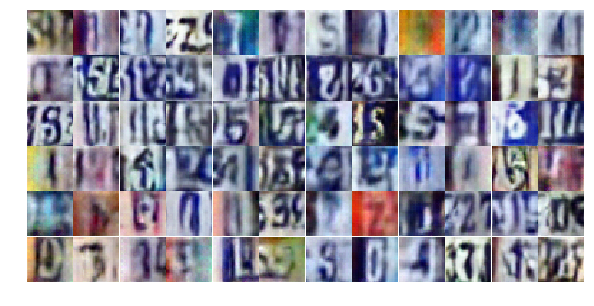

Epoch 8/20... Discriminator Loss: 0.7132... Generator Loss: 1.2412
Epoch 8/20... Discriminator Loss: 1.1039... Generator Loss: 0.5730
Epoch 8/20... Discriminator Loss: 1.0727... Generator Loss: 0.7513
Epoch 8/20... Discriminator Loss: 0.8735... Generator Loss: 2.2205
Epoch 8/20... Discriminator Loss: 1.1753... Generator Loss: 0.6001
Epoch 8/20... Discriminator Loss: 1.5896... Generator Loss: 2.4919
Epoch 8/20... Discriminator Loss: 1.1650... Generator Loss: 0.6657
Epoch 8/20... Discriminator Loss: 0.8304... Generator Loss: 1.1065
Epoch 8/20... Discriminator Loss: 1.0226... Generator Loss: 0.9249
Epoch 8/20... Discriminator Loss: 1.4333... Generator Loss: 0.3466


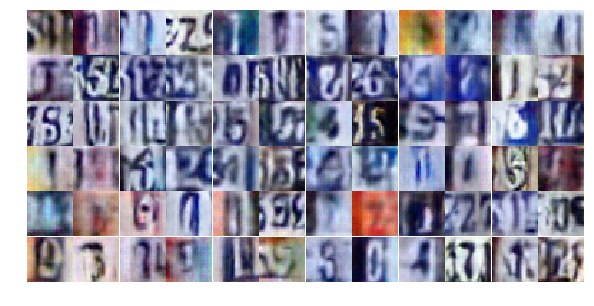

Epoch 8/20... Discriminator Loss: 0.7871... Generator Loss: 0.9889
Epoch 8/20... Discriminator Loss: 1.0441... Generator Loss: 0.6289
Epoch 8/20... Discriminator Loss: 0.8239... Generator Loss: 0.9817
Epoch 8/20... Discriminator Loss: 0.8949... Generator Loss: 0.8861
Epoch 8/20... Discriminator Loss: 1.2299... Generator Loss: 0.5538
Epoch 8/20... Discriminator Loss: 0.5758... Generator Loss: 1.2919
Epoch 8/20... Discriminator Loss: 1.6210... Generator Loss: 0.8085
Epoch 8/20... Discriminator Loss: 2.3134... Generator Loss: 0.1636
Epoch 8/20... Discriminator Loss: 0.8888... Generator Loss: 1.0043
Epoch 8/20... Discriminator Loss: 1.0350... Generator Loss: 0.7106


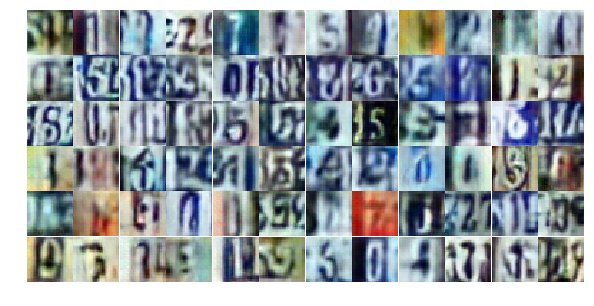

Epoch 8/20... Discriminator Loss: 1.1576... Generator Loss: 1.3080
Epoch 8/20... Discriminator Loss: 1.0692... Generator Loss: 0.6745
Epoch 8/20... Discriminator Loss: 0.8903... Generator Loss: 0.7527
Epoch 8/20... Discriminator Loss: 1.0382... Generator Loss: 0.9709
Epoch 8/20... Discriminator Loss: 0.9278... Generator Loss: 1.8132
Epoch 8/20... Discriminator Loss: 0.7168... Generator Loss: 1.0179
Epoch 8/20... Discriminator Loss: 0.7025... Generator Loss: 1.2664
Epoch 8/20... Discriminator Loss: 1.0621... Generator Loss: 0.7200
Epoch 8/20... Discriminator Loss: 1.6053... Generator Loss: 0.3065
Epoch 8/20... Discriminator Loss: 1.6510... Generator Loss: 0.3105


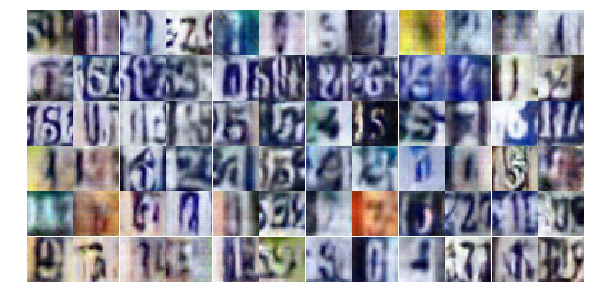

Epoch 8/20... Discriminator Loss: 1.0944... Generator Loss: 0.9830
Epoch 8/20... Discriminator Loss: 1.1456... Generator Loss: 0.5871
Epoch 8/20... Discriminator Loss: 0.9476... Generator Loss: 0.7625
Epoch 8/20... Discriminator Loss: 1.0543... Generator Loss: 1.9744
Epoch 8/20... Discriminator Loss: 0.7984... Generator Loss: 1.1840
Epoch 8/20... Discriminator Loss: 1.0446... Generator Loss: 0.6677
Epoch 8/20... Discriminator Loss: 0.7420... Generator Loss: 1.1008
Epoch 8/20... Discriminator Loss: 1.0373... Generator Loss: 1.4670
Epoch 9/20... Discriminator Loss: 1.2584... Generator Loss: 0.6559
Epoch 9/20... Discriminator Loss: 1.3701... Generator Loss: 0.4079


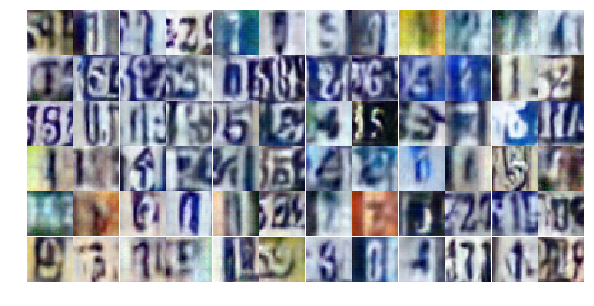

Epoch 9/20... Discriminator Loss: 1.4730... Generator Loss: 0.3522
Epoch 9/20... Discriminator Loss: 0.8461... Generator Loss: 1.4140
Epoch 9/20... Discriminator Loss: 2.1340... Generator Loss: 0.2668
Epoch 9/20... Discriminator Loss: 0.6350... Generator Loss: 1.1574
Epoch 9/20... Discriminator Loss: 1.1427... Generator Loss: 0.5929
Epoch 9/20... Discriminator Loss: 0.9953... Generator Loss: 1.2614
Epoch 9/20... Discriminator Loss: 1.1634... Generator Loss: 0.5816
Epoch 9/20... Discriminator Loss: 1.0540... Generator Loss: 0.7663
Epoch 9/20... Discriminator Loss: 1.4315... Generator Loss: 0.3632
Epoch 9/20... Discriminator Loss: 1.4093... Generator Loss: 0.3886


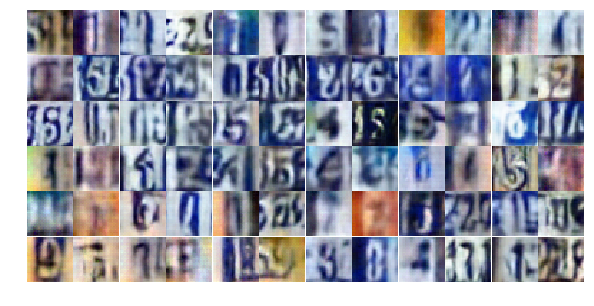

Epoch 9/20... Discriminator Loss: 1.7680... Generator Loss: 2.3783
Epoch 9/20... Discriminator Loss: 1.2311... Generator Loss: 0.5482
Epoch 9/20... Discriminator Loss: 0.7917... Generator Loss: 0.9806
Epoch 9/20... Discriminator Loss: 1.3699... Generator Loss: 0.5276
Epoch 9/20... Discriminator Loss: 1.0684... Generator Loss: 0.6441
Epoch 9/20... Discriminator Loss: 0.8804... Generator Loss: 0.9178
Epoch 9/20... Discriminator Loss: 1.3818... Generator Loss: 0.4389
Epoch 9/20... Discriminator Loss: 1.2937... Generator Loss: 0.4782
Epoch 9/20... Discriminator Loss: 1.4429... Generator Loss: 0.3999
Epoch 9/20... Discriminator Loss: 1.0418... Generator Loss: 0.6540


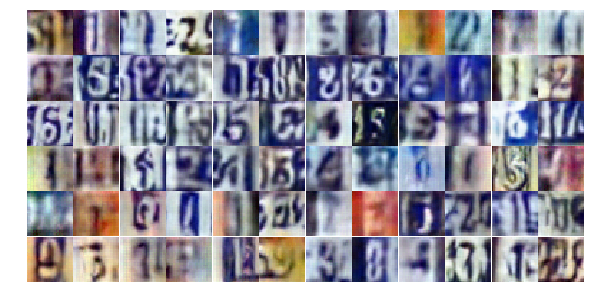

Epoch 9/20... Discriminator Loss: 1.2757... Generator Loss: 0.4914
Epoch 9/20... Discriminator Loss: 1.0175... Generator Loss: 0.9115
Epoch 9/20... Discriminator Loss: 0.7736... Generator Loss: 1.5649
Epoch 9/20... Discriminator Loss: 0.7727... Generator Loss: 0.9705
Epoch 9/20... Discriminator Loss: 0.4229... Generator Loss: 1.7416
Epoch 9/20... Discriminator Loss: 0.7391... Generator Loss: 1.8578
Epoch 9/20... Discriminator Loss: 1.1476... Generator Loss: 0.5708
Epoch 9/20... Discriminator Loss: 0.8570... Generator Loss: 1.6675
Epoch 9/20... Discriminator Loss: 0.7881... Generator Loss: 1.3712
Epoch 9/20... Discriminator Loss: 1.0178... Generator Loss: 0.6329


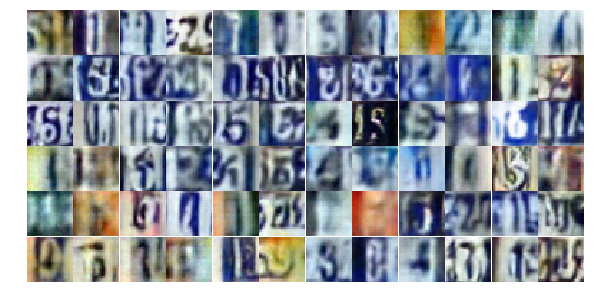

Epoch 9/20... Discriminator Loss: 0.6737... Generator Loss: 1.2577
Epoch 9/20... Discriminator Loss: 1.0948... Generator Loss: 0.6566
Epoch 9/20... Discriminator Loss: 1.4587... Generator Loss: 0.3778
Epoch 9/20... Discriminator Loss: 0.8644... Generator Loss: 1.1146
Epoch 9/20... Discriminator Loss: 0.9176... Generator Loss: 0.8855
Epoch 9/20... Discriminator Loss: 0.9926... Generator Loss: 1.4289
Epoch 9/20... Discriminator Loss: 0.8948... Generator Loss: 0.9785
Epoch 9/20... Discriminator Loss: 0.6088... Generator Loss: 1.8423
Epoch 9/20... Discriminator Loss: 0.6135... Generator Loss: 1.1197
Epoch 9/20... Discriminator Loss: 0.9786... Generator Loss: 1.0245


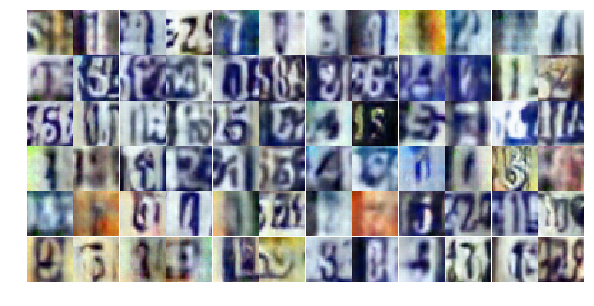

Epoch 9/20... Discriminator Loss: 0.8317... Generator Loss: 1.6312
Epoch 9/20... Discriminator Loss: 1.0396... Generator Loss: 0.9730
Epoch 9/20... Discriminator Loss: 1.0019... Generator Loss: 0.6824
Epoch 9/20... Discriminator Loss: 1.5707... Generator Loss: 3.1232
Epoch 9/20... Discriminator Loss: 0.8602... Generator Loss: 1.5110
Epoch 9/20... Discriminator Loss: 1.0971... Generator Loss: 0.7306
Epoch 9/20... Discriminator Loss: 1.0752... Generator Loss: 1.2881
Epoch 9/20... Discriminator Loss: 0.9082... Generator Loss: 1.0238
Epoch 9/20... Discriminator Loss: 1.1147... Generator Loss: 0.7128
Epoch 9/20... Discriminator Loss: 1.3223... Generator Loss: 1.3835


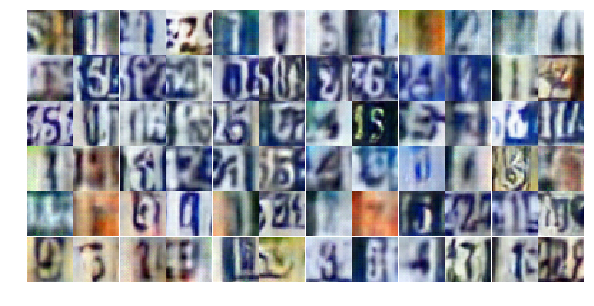

Epoch 9/20... Discriminator Loss: 1.2211... Generator Loss: 0.5731
Epoch 9/20... Discriminator Loss: 1.2282... Generator Loss: 1.3082
Epoch 9/20... Discriminator Loss: 1.1617... Generator Loss: 0.6882
Epoch 9/20... Discriminator Loss: 1.6750... Generator Loss: 0.2827
Epoch 9/20... Discriminator Loss: 0.8316... Generator Loss: 0.9584
Epoch 10/20... Discriminator Loss: 1.0079... Generator Loss: 0.8817
Epoch 10/20... Discriminator Loss: 0.8999... Generator Loss: 0.9273
Epoch 10/20... Discriminator Loss: 0.7409... Generator Loss: 0.9932
Epoch 10/20... Discriminator Loss: 0.9222... Generator Loss: 1.0743
Epoch 10/20... Discriminator Loss: 1.9034... Generator Loss: 0.2341


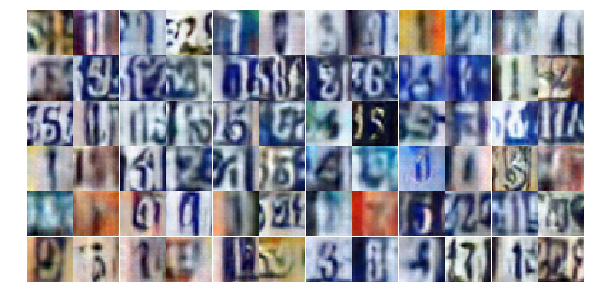

Epoch 10/20... Discriminator Loss: 1.0837... Generator Loss: 0.7554
Epoch 10/20... Discriminator Loss: 0.8110... Generator Loss: 1.0359
Epoch 10/20... Discriminator Loss: 1.1154... Generator Loss: 0.6082
Epoch 10/20... Discriminator Loss: 1.0597... Generator Loss: 0.9646
Epoch 10/20... Discriminator Loss: 0.8426... Generator Loss: 1.0011
Epoch 10/20... Discriminator Loss: 1.3623... Generator Loss: 0.4455
Epoch 10/20... Discriminator Loss: 0.8378... Generator Loss: 0.8173
Epoch 10/20... Discriminator Loss: 1.4179... Generator Loss: 0.3910
Epoch 10/20... Discriminator Loss: 1.3842... Generator Loss: 0.4423
Epoch 10/20... Discriminator Loss: 1.0337... Generator Loss: 0.8543


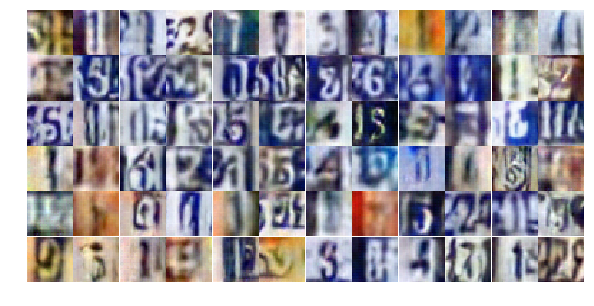

Epoch 10/20... Discriminator Loss: 1.2286... Generator Loss: 0.6174
Epoch 10/20... Discriminator Loss: 1.8570... Generator Loss: 0.2792
Epoch 10/20... Discriminator Loss: 0.9772... Generator Loss: 1.1611
Epoch 10/20... Discriminator Loss: 1.1224... Generator Loss: 0.7506
Epoch 10/20... Discriminator Loss: 0.7919... Generator Loss: 1.1832
Epoch 10/20... Discriminator Loss: 0.7385... Generator Loss: 1.0777
Epoch 10/20... Discriminator Loss: 1.1142... Generator Loss: 0.7531
Epoch 10/20... Discriminator Loss: 0.6982... Generator Loss: 1.1246
Epoch 10/20... Discriminator Loss: 0.8704... Generator Loss: 1.0145
Epoch 10/20... Discriminator Loss: 0.5994... Generator Loss: 3.1118


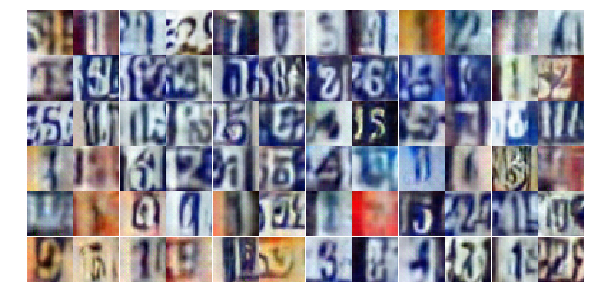

Epoch 10/20... Discriminator Loss: 1.4239... Generator Loss: 0.4829
Epoch 10/20... Discriminator Loss: 0.8528... Generator Loss: 0.8829
Epoch 10/20... Discriminator Loss: 0.6502... Generator Loss: 2.2576
Epoch 10/20... Discriminator Loss: 1.7322... Generator Loss: 2.4415
Epoch 10/20... Discriminator Loss: 1.2396... Generator Loss: 0.5751
Epoch 10/20... Discriminator Loss: 1.2805... Generator Loss: 0.4744
Epoch 10/20... Discriminator Loss: 0.6631... Generator Loss: 1.1719
Epoch 10/20... Discriminator Loss: 1.1436... Generator Loss: 0.5504
Epoch 10/20... Discriminator Loss: 0.8064... Generator Loss: 0.9597
Epoch 10/20... Discriminator Loss: 0.6889... Generator Loss: 1.0407


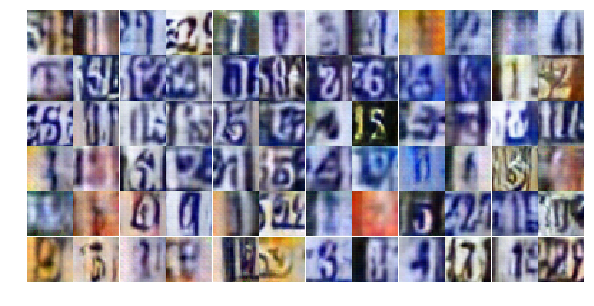

Epoch 10/20... Discriminator Loss: 0.9252... Generator Loss: 0.8197
Epoch 10/20... Discriminator Loss: 1.2442... Generator Loss: 0.5311
Epoch 10/20... Discriminator Loss: 1.0250... Generator Loss: 0.6843
Epoch 10/20... Discriminator Loss: 1.3072... Generator Loss: 0.5326
Epoch 10/20... Discriminator Loss: 1.3361... Generator Loss: 1.0023
Epoch 10/20... Discriminator Loss: 2.0538... Generator Loss: 0.3537
Epoch 10/20... Discriminator Loss: 0.9413... Generator Loss: 1.1836
Epoch 10/20... Discriminator Loss: 1.1872... Generator Loss: 0.5187
Epoch 10/20... Discriminator Loss: 1.1493... Generator Loss: 0.6602
Epoch 10/20... Discriminator Loss: 0.9224... Generator Loss: 1.3337


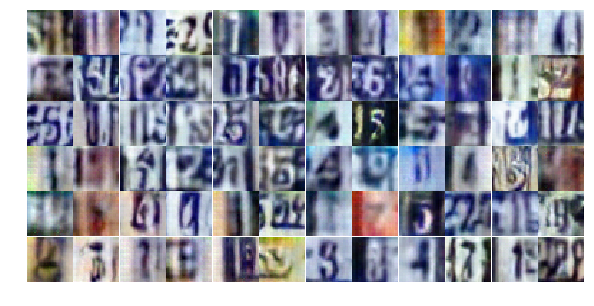

Epoch 10/20... Discriminator Loss: 0.7901... Generator Loss: 0.8698
Epoch 10/20... Discriminator Loss: 1.1637... Generator Loss: 0.5885
Epoch 10/20... Discriminator Loss: 1.2738... Generator Loss: 0.5247
Epoch 10/20... Discriminator Loss: 1.2218... Generator Loss: 0.6247
Epoch 10/20... Discriminator Loss: 0.8311... Generator Loss: 1.2251
Epoch 10/20... Discriminator Loss: 0.7013... Generator Loss: 1.0777
Epoch 10/20... Discriminator Loss: 1.2946... Generator Loss: 0.5171
Epoch 10/20... Discriminator Loss: 1.0887... Generator Loss: 0.6359
Epoch 10/20... Discriminator Loss: 0.9559... Generator Loss: 1.2248
Epoch 10/20... Discriminator Loss: 1.0320... Generator Loss: 1.0309


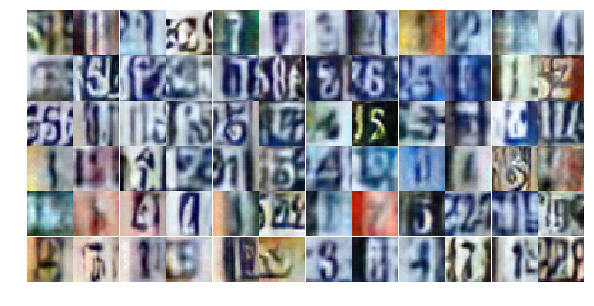

Epoch 10/20... Discriminator Loss: 1.6052... Generator Loss: 1.8704
Epoch 10/20... Discriminator Loss: 0.9739... Generator Loss: 0.7823
Epoch 10/20... Discriminator Loss: 0.8602... Generator Loss: 0.8041
Epoch 11/20... Discriminator Loss: 1.1794... Generator Loss: 0.7071
Epoch 11/20... Discriminator Loss: 1.1400... Generator Loss: 0.5824
Epoch 11/20... Discriminator Loss: 1.7300... Generator Loss: 0.3007
Epoch 11/20... Discriminator Loss: 0.8649... Generator Loss: 0.8824
Epoch 11/20... Discriminator Loss: 0.8485... Generator Loss: 1.4236
Epoch 11/20... Discriminator Loss: 1.4825... Generator Loss: 0.3923
Epoch 11/20... Discriminator Loss: 0.6750... Generator Loss: 1.0429


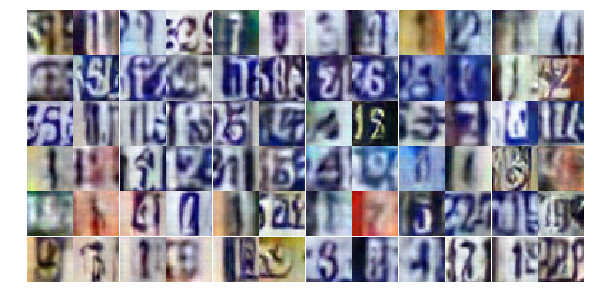

Epoch 11/20... Discriminator Loss: 0.6537... Generator Loss: 1.3451
Epoch 11/20... Discriminator Loss: 0.8128... Generator Loss: 1.0472
Epoch 11/20... Discriminator Loss: 1.2831... Generator Loss: 0.4549
Epoch 11/20... Discriminator Loss: 0.7451... Generator Loss: 1.2777
Epoch 11/20... Discriminator Loss: 1.0259... Generator Loss: 1.4001
Epoch 11/20... Discriminator Loss: 0.7560... Generator Loss: 1.2407
Epoch 11/20... Discriminator Loss: 1.1324... Generator Loss: 0.6225
Epoch 11/20... Discriminator Loss: 0.7228... Generator Loss: 1.4450
Epoch 11/20... Discriminator Loss: 1.0038... Generator Loss: 0.6875
Epoch 11/20... Discriminator Loss: 1.4452... Generator Loss: 0.4140


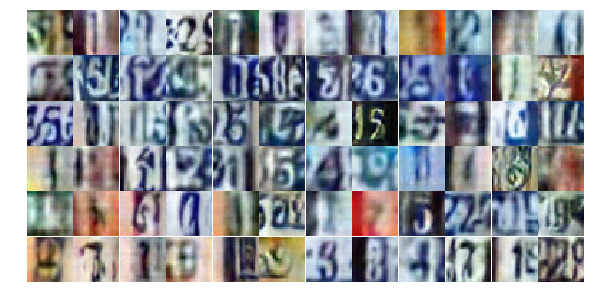

Epoch 11/20... Discriminator Loss: 1.1386... Generator Loss: 0.7456
Epoch 11/20... Discriminator Loss: 0.8775... Generator Loss: 1.2469
Epoch 11/20... Discriminator Loss: 0.8645... Generator Loss: 0.8438
Epoch 11/20... Discriminator Loss: 0.5719... Generator Loss: 1.3600
Epoch 11/20... Discriminator Loss: 0.5685... Generator Loss: 1.3218
Epoch 11/20... Discriminator Loss: 0.5875... Generator Loss: 1.5602
Epoch 11/20... Discriminator Loss: 0.9750... Generator Loss: 0.8141
Epoch 11/20... Discriminator Loss: 1.1790... Generator Loss: 0.9349
Epoch 11/20... Discriminator Loss: 0.4809... Generator Loss: 1.8755
Epoch 11/20... Discriminator Loss: 1.8845... Generator Loss: 0.2287


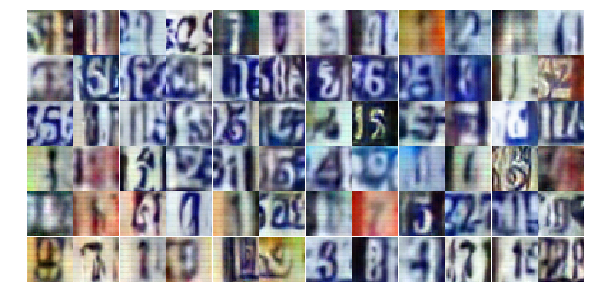

Epoch 11/20... Discriminator Loss: 1.0631... Generator Loss: 0.6653
Epoch 11/20... Discriminator Loss: 0.9756... Generator Loss: 0.7345
Epoch 11/20... Discriminator Loss: 0.8929... Generator Loss: 1.0062
Epoch 11/20... Discriminator Loss: 0.7015... Generator Loss: 1.3970
Epoch 11/20... Discriminator Loss: 1.7431... Generator Loss: 0.2775
Epoch 11/20... Discriminator Loss: 1.0186... Generator Loss: 0.8490
Epoch 11/20... Discriminator Loss: 2.0518... Generator Loss: 0.2235
Epoch 11/20... Discriminator Loss: 1.1076... Generator Loss: 0.6458
Epoch 11/20... Discriminator Loss: 0.4581... Generator Loss: 1.4623
Epoch 11/20... Discriminator Loss: 0.6986... Generator Loss: 1.0813


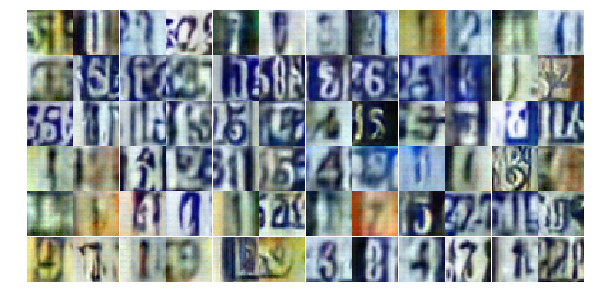

Epoch 11/20... Discriminator Loss: 0.7999... Generator Loss: 0.8620
Epoch 11/20... Discriminator Loss: 4.0427... Generator Loss: 3.7821
Epoch 11/20... Discriminator Loss: 1.2720... Generator Loss: 0.7056
Epoch 11/20... Discriminator Loss: 1.0692... Generator Loss: 0.7877
Epoch 11/20... Discriminator Loss: 1.1907... Generator Loss: 0.5786
Epoch 11/20... Discriminator Loss: 0.9348... Generator Loss: 0.8928
Epoch 11/20... Discriminator Loss: 0.6811... Generator Loss: 1.5668
Epoch 11/20... Discriminator Loss: 1.0830... Generator Loss: 0.6247
Epoch 11/20... Discriminator Loss: 1.2525... Generator Loss: 0.4641
Epoch 11/20... Discriminator Loss: 0.8153... Generator Loss: 0.9515


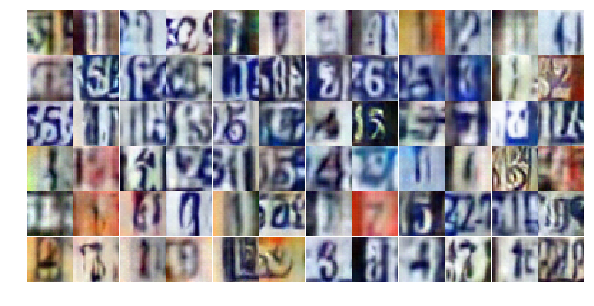

Epoch 11/20... Discriminator Loss: 1.1432... Generator Loss: 0.6470
Epoch 11/20... Discriminator Loss: 0.8053... Generator Loss: 0.9577
Epoch 11/20... Discriminator Loss: 0.8424... Generator Loss: 1.1510
Epoch 11/20... Discriminator Loss: 1.3227... Generator Loss: 0.5095
Epoch 11/20... Discriminator Loss: 1.5219... Generator Loss: 0.3400
Epoch 11/20... Discriminator Loss: 0.9262... Generator Loss: 0.8265
Epoch 11/20... Discriminator Loss: 0.9605... Generator Loss: 0.7841
Epoch 11/20... Discriminator Loss: 1.1878... Generator Loss: 0.5965
Epoch 11/20... Discriminator Loss: 1.4423... Generator Loss: 0.4431
Epoch 11/20... Discriminator Loss: 1.3124... Generator Loss: 0.5367


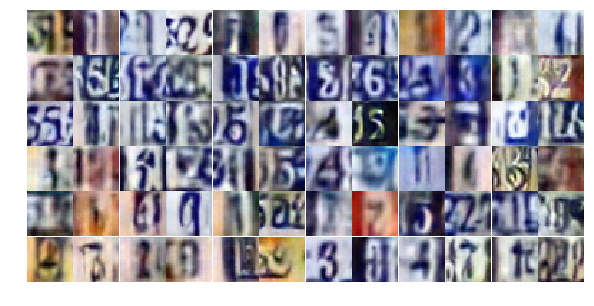

Epoch 12/20... Discriminator Loss: 0.9701... Generator Loss: 0.8224
Epoch 12/20... Discriminator Loss: 0.9540... Generator Loss: 0.8423
Epoch 12/20... Discriminator Loss: 0.6829... Generator Loss: 1.3921
Epoch 12/20... Discriminator Loss: 0.5051... Generator Loss: 1.4954
Epoch 12/20... Discriminator Loss: 1.2358... Generator Loss: 0.5648
Epoch 12/20... Discriminator Loss: 1.1113... Generator Loss: 0.5702
Epoch 12/20... Discriminator Loss: 0.7872... Generator Loss: 1.2176
Epoch 12/20... Discriminator Loss: 2.1648... Generator Loss: 0.4851
Epoch 12/20... Discriminator Loss: 1.4231... Generator Loss: 1.0718
Epoch 12/20... Discriminator Loss: 1.4633... Generator Loss: 0.4142


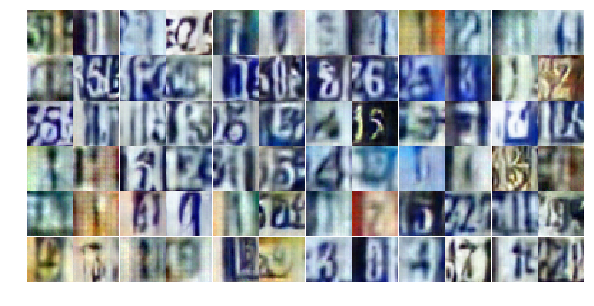

Epoch 12/20... Discriminator Loss: 0.9132... Generator Loss: 0.9311
Epoch 12/20... Discriminator Loss: 0.8065... Generator Loss: 0.9862
Epoch 12/20... Discriminator Loss: 0.6766... Generator Loss: 1.6550
Epoch 12/20... Discriminator Loss: 0.7473... Generator Loss: 1.1946
Epoch 12/20... Discriminator Loss: 0.6278... Generator Loss: 1.3694
Epoch 12/20... Discriminator Loss: 1.0765... Generator Loss: 0.6631
Epoch 12/20... Discriminator Loss: 2.4505... Generator Loss: 0.1408
Epoch 12/20... Discriminator Loss: 1.0399... Generator Loss: 0.7614
Epoch 12/20... Discriminator Loss: 0.8016... Generator Loss: 1.1178
Epoch 12/20... Discriminator Loss: 0.9015... Generator Loss: 1.0277


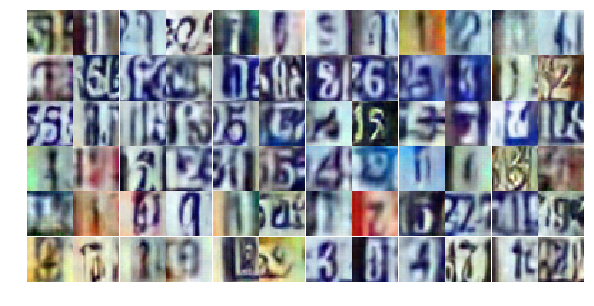

Epoch 12/20... Discriminator Loss: 0.5207... Generator Loss: 2.1735
Epoch 12/20... Discriminator Loss: 0.7250... Generator Loss: 1.4348
Epoch 12/20... Discriminator Loss: 0.4935... Generator Loss: 1.5053
Epoch 12/20... Discriminator Loss: 0.6595... Generator Loss: 3.0904
Epoch 12/20... Discriminator Loss: 0.6568... Generator Loss: 1.3327
Epoch 12/20... Discriminator Loss: 0.3951... Generator Loss: 2.0621
Epoch 12/20... Discriminator Loss: 0.7477... Generator Loss: 0.9224
Epoch 12/20... Discriminator Loss: 0.5251... Generator Loss: 1.8053
Epoch 12/20... Discriminator Loss: 0.9671... Generator Loss: 0.8512
Epoch 12/20... Discriminator Loss: 1.3802... Generator Loss: 0.4737


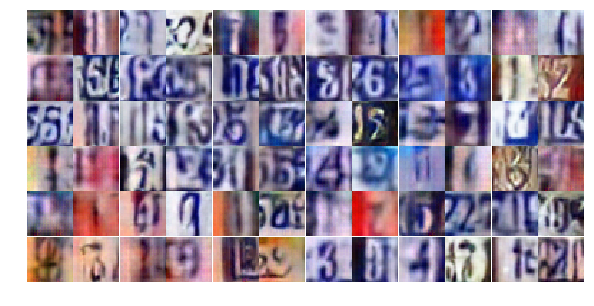

Epoch 12/20... Discriminator Loss: 0.9619... Generator Loss: 0.8917
Epoch 12/20... Discriminator Loss: 1.0819... Generator Loss: 0.6377
Epoch 12/20... Discriminator Loss: 1.2929... Generator Loss: 0.4995
Epoch 12/20... Discriminator Loss: 1.8063... Generator Loss: 0.2586
Epoch 12/20... Discriminator Loss: 0.6620... Generator Loss: 1.8378
Epoch 12/20... Discriminator Loss: 0.9321... Generator Loss: 0.8208
Epoch 12/20... Discriminator Loss: 1.2170... Generator Loss: 0.5125
Epoch 12/20... Discriminator Loss: 0.6738... Generator Loss: 1.1579
Epoch 12/20... Discriminator Loss: 0.3915... Generator Loss: 1.9512
Epoch 12/20... Discriminator Loss: 0.2568... Generator Loss: 2.1750


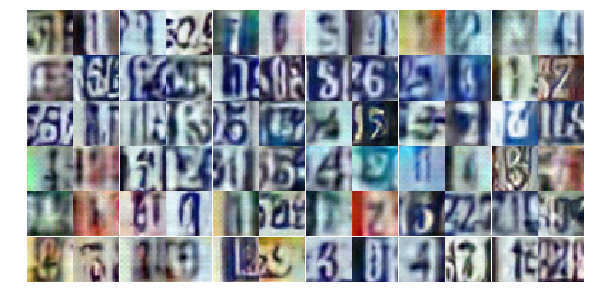

Epoch 12/20... Discriminator Loss: 0.3648... Generator Loss: 1.9184
Epoch 12/20... Discriminator Loss: 0.6734... Generator Loss: 0.9840
Epoch 12/20... Discriminator Loss: 0.4325... Generator Loss: 1.5910
Epoch 12/20... Discriminator Loss: 1.3132... Generator Loss: 0.4917
Epoch 12/20... Discriminator Loss: 0.2000... Generator Loss: 2.9009
Epoch 12/20... Discriminator Loss: 0.4354... Generator Loss: 1.5150
Epoch 12/20... Discriminator Loss: 0.3257... Generator Loss: 1.7592
Epoch 12/20... Discriminator Loss: 1.9670... Generator Loss: 0.2269
Epoch 12/20... Discriminator Loss: 3.8261... Generator Loss: 0.1873
Epoch 12/20... Discriminator Loss: 1.7406... Generator Loss: 1.0408


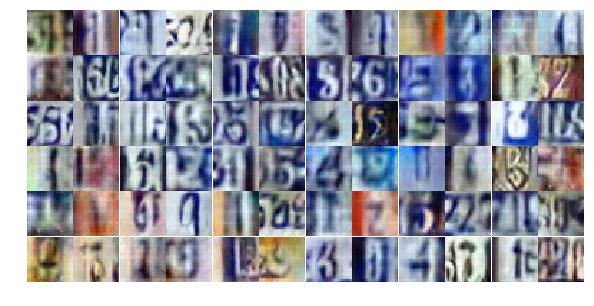

Epoch 12/20... Discriminator Loss: 1.3057... Generator Loss: 0.5241
Epoch 12/20... Discriminator Loss: 0.9995... Generator Loss: 0.7625
Epoch 12/20... Discriminator Loss: 1.0441... Generator Loss: 1.4285
Epoch 12/20... Discriminator Loss: 1.4010... Generator Loss: 0.4382
Epoch 12/20... Discriminator Loss: 0.8609... Generator Loss: 0.9137
Epoch 12/20... Discriminator Loss: 1.0635... Generator Loss: 1.5593
Epoch 12/20... Discriminator Loss: 1.1124... Generator Loss: 0.6658
Epoch 13/20... Discriminator Loss: 0.8814... Generator Loss: 0.9942
Epoch 13/20... Discriminator Loss: 1.0216... Generator Loss: 0.7936
Epoch 13/20... Discriminator Loss: 1.5027... Generator Loss: 0.3798


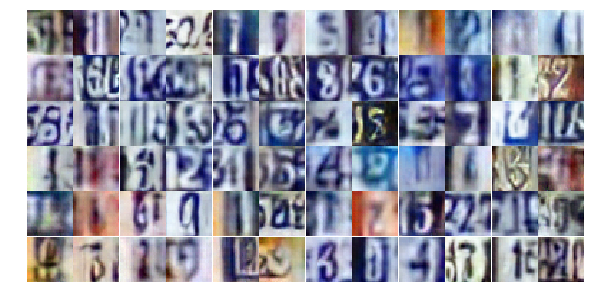

Epoch 13/20... Discriminator Loss: 0.7529... Generator Loss: 1.3081
Epoch 13/20... Discriminator Loss: 0.6143... Generator Loss: 1.6178
Epoch 13/20... Discriminator Loss: 1.4601... Generator Loss: 0.4276
Epoch 13/20... Discriminator Loss: 1.4776... Generator Loss: 0.3876
Epoch 13/20... Discriminator Loss: 0.8829... Generator Loss: 1.0598
Epoch 13/20... Discriminator Loss: 1.1360... Generator Loss: 0.5789
Epoch 13/20... Discriminator Loss: 0.8458... Generator Loss: 0.9429
Epoch 13/20... Discriminator Loss: 0.7843... Generator Loss: 1.4706
Epoch 13/20... Discriminator Loss: 1.0685... Generator Loss: 0.6016
Epoch 13/20... Discriminator Loss: 0.8319... Generator Loss: 0.9740


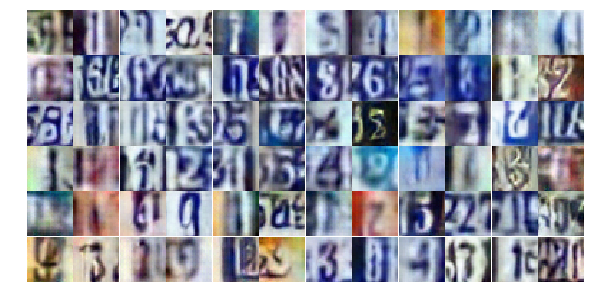

Epoch 13/20... Discriminator Loss: 1.0076... Generator Loss: 1.8841
Epoch 13/20... Discriminator Loss: 0.8703... Generator Loss: 0.9256
Epoch 13/20... Discriminator Loss: 0.8586... Generator Loss: 1.2972
Epoch 13/20... Discriminator Loss: 1.1785... Generator Loss: 0.9995
Epoch 13/20... Discriminator Loss: 0.8127... Generator Loss: 1.1934
Epoch 13/20... Discriminator Loss: 0.9737... Generator Loss: 0.8049
Epoch 13/20... Discriminator Loss: 0.8791... Generator Loss: 0.8764
Epoch 13/20... Discriminator Loss: 1.4389... Generator Loss: 0.4276
Epoch 13/20... Discriminator Loss: 0.7357... Generator Loss: 1.1814
Epoch 13/20... Discriminator Loss: 1.4027... Generator Loss: 0.4147


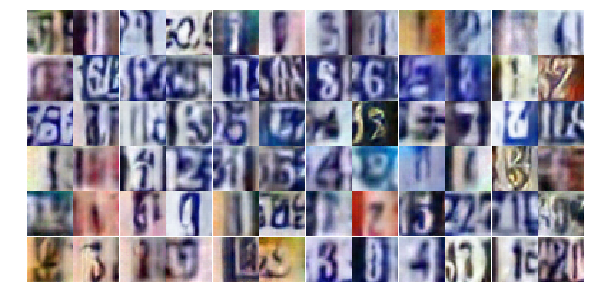

Epoch 13/20... Discriminator Loss: 1.4899... Generator Loss: 0.4048
Epoch 13/20... Discriminator Loss: 1.2396... Generator Loss: 0.6077
Epoch 13/20... Discriminator Loss: 0.6364... Generator Loss: 1.7065
Epoch 13/20... Discriminator Loss: 0.8036... Generator Loss: 0.8696
Epoch 13/20... Discriminator Loss: 0.9056... Generator Loss: 0.8018
Epoch 13/20... Discriminator Loss: 1.9611... Generator Loss: 0.3237
Epoch 13/20... Discriminator Loss: 1.3053... Generator Loss: 1.3830
Epoch 13/20... Discriminator Loss: 0.7985... Generator Loss: 1.3734
Epoch 13/20... Discriminator Loss: 0.6097... Generator Loss: 1.3683
Epoch 13/20... Discriminator Loss: 0.7462... Generator Loss: 1.0256


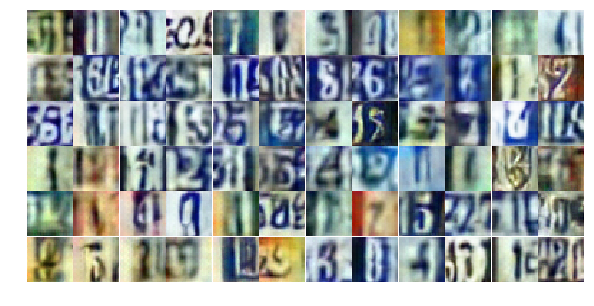

Epoch 13/20... Discriminator Loss: 1.3747... Generator Loss: 0.4408
Epoch 13/20... Discriminator Loss: 1.0232... Generator Loss: 0.7207
Epoch 13/20... Discriminator Loss: 1.0186... Generator Loss: 0.7205
Epoch 13/20... Discriminator Loss: 1.0392... Generator Loss: 0.6643
Epoch 13/20... Discriminator Loss: 0.6060... Generator Loss: 1.2757
Epoch 13/20... Discriminator Loss: 0.3866... Generator Loss: 1.9605
Epoch 13/20... Discriminator Loss: 0.4559... Generator Loss: 4.6460
Epoch 13/20... Discriminator Loss: 0.3568... Generator Loss: 1.8472
Epoch 13/20... Discriminator Loss: 0.6852... Generator Loss: 0.9563
Epoch 13/20... Discriminator Loss: 0.5237... Generator Loss: 1.2718


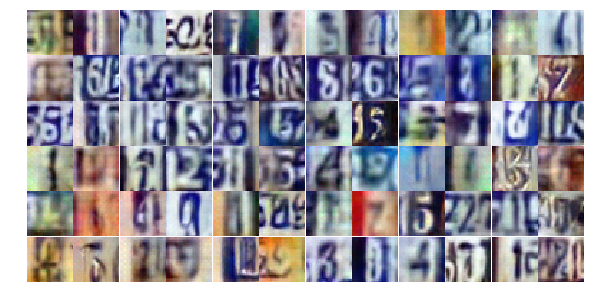

Epoch 13/20... Discriminator Loss: 0.2931... Generator Loss: 1.9380
Epoch 13/20... Discriminator Loss: 0.8504... Generator Loss: 0.8271
Epoch 13/20... Discriminator Loss: 0.9997... Generator Loss: 4.5472
Epoch 13/20... Discriminator Loss: 2.4283... Generator Loss: 0.4877
Epoch 13/20... Discriminator Loss: 1.8046... Generator Loss: 0.7951
Epoch 13/20... Discriminator Loss: 1.5542... Generator Loss: 1.0483
Epoch 13/20... Discriminator Loss: 1.3815... Generator Loss: 1.0617
Epoch 13/20... Discriminator Loss: 1.5749... Generator Loss: 1.1433
Epoch 13/20... Discriminator Loss: 1.2714... Generator Loss: 0.7382
Epoch 13/20... Discriminator Loss: 1.3842... Generator Loss: 0.8964


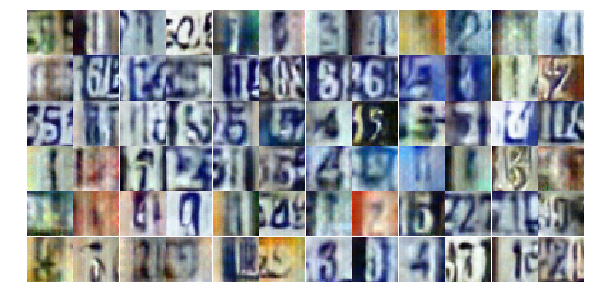

Epoch 13/20... Discriminator Loss: 1.0312... Generator Loss: 2.7639
Epoch 13/20... Discriminator Loss: 1.0859... Generator Loss: 1.4149
Epoch 13/20... Discriminator Loss: 0.9540... Generator Loss: 0.9475
Epoch 13/20... Discriminator Loss: 1.2421... Generator Loss: 0.6094
Epoch 14/20... Discriminator Loss: 1.0514... Generator Loss: 0.8022
Epoch 14/20... Discriminator Loss: 1.6958... Generator Loss: 2.2967
Epoch 14/20... Discriminator Loss: 1.2020... Generator Loss: 0.6134
Epoch 14/20... Discriminator Loss: 0.9625... Generator Loss: 1.5191
Epoch 14/20... Discriminator Loss: 0.8348... Generator Loss: 1.4573
Epoch 14/20... Discriminator Loss: 1.0876... Generator Loss: 0.6625


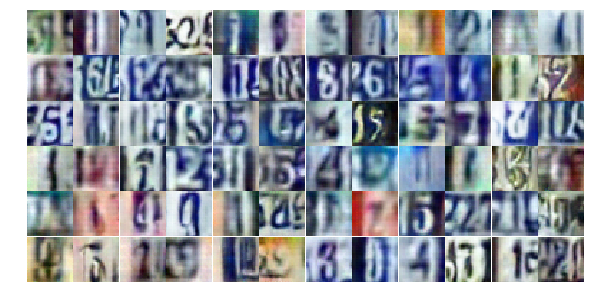

Epoch 14/20... Discriminator Loss: 0.9672... Generator Loss: 1.0459
Epoch 14/20... Discriminator Loss: 1.2270... Generator Loss: 0.5083
Epoch 14/20... Discriminator Loss: 0.9921... Generator Loss: 0.8097
Epoch 14/20... Discriminator Loss: 1.0201... Generator Loss: 1.0557
Epoch 14/20... Discriminator Loss: 1.2389... Generator Loss: 0.5459
Epoch 14/20... Discriminator Loss: 0.8880... Generator Loss: 0.7863
Epoch 14/20... Discriminator Loss: 0.8685... Generator Loss: 1.2243
Epoch 14/20... Discriminator Loss: 1.3857... Generator Loss: 0.4632
Epoch 14/20... Discriminator Loss: 1.4459... Generator Loss: 0.5509
Epoch 14/20... Discriminator Loss: 1.5957... Generator Loss: 0.3300


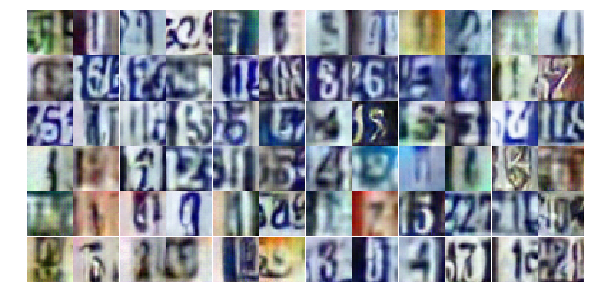

Epoch 14/20... Discriminator Loss: 1.0116... Generator Loss: 0.5899
Epoch 14/20... Discriminator Loss: 1.2173... Generator Loss: 1.7079
Epoch 14/20... Discriminator Loss: 1.3075... Generator Loss: 0.5247
Epoch 14/20... Discriminator Loss: 0.9176... Generator Loss: 0.7569
Epoch 14/20... Discriminator Loss: 1.0722... Generator Loss: 0.7478
Epoch 14/20... Discriminator Loss: 1.1468... Generator Loss: 0.5618
Epoch 14/20... Discriminator Loss: 1.0417... Generator Loss: 0.6524
Epoch 14/20... Discriminator Loss: 1.2872... Generator Loss: 0.4804
Epoch 14/20... Discriminator Loss: 0.8150... Generator Loss: 1.1561
Epoch 14/20... Discriminator Loss: 0.9603... Generator Loss: 1.0777


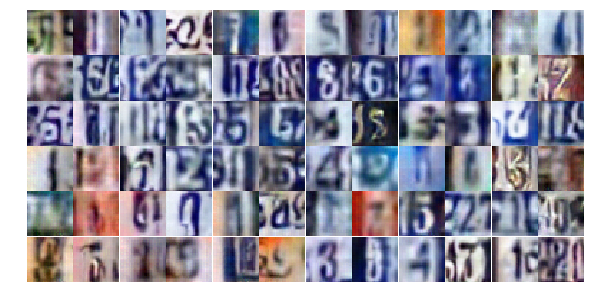

Epoch 14/20... Discriminator Loss: 1.5589... Generator Loss: 0.4168
Epoch 14/20... Discriminator Loss: 0.6765... Generator Loss: 1.7057
Epoch 14/20... Discriminator Loss: 0.8527... Generator Loss: 0.8360
Epoch 14/20... Discriminator Loss: 0.5934... Generator Loss: 1.3910
Epoch 14/20... Discriminator Loss: 0.7635... Generator Loss: 1.2704
Epoch 14/20... Discriminator Loss: 0.9210... Generator Loss: 0.8347
Epoch 14/20... Discriminator Loss: 0.9530... Generator Loss: 0.7676
Epoch 14/20... Discriminator Loss: 0.6021... Generator Loss: 1.6132
Epoch 14/20... Discriminator Loss: 0.6732... Generator Loss: 1.4324
Epoch 14/20... Discriminator Loss: 1.1435... Generator Loss: 0.5949


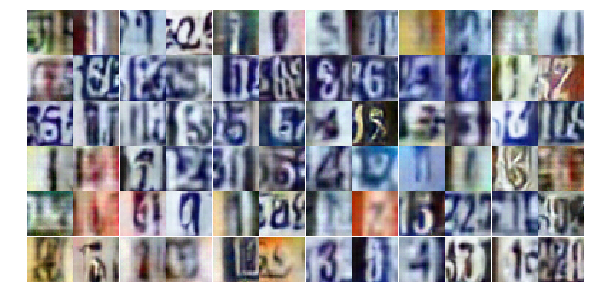

Epoch 14/20... Discriminator Loss: 1.3979... Generator Loss: 0.4028
Epoch 14/20... Discriminator Loss: 1.0208... Generator Loss: 1.2853
Epoch 14/20... Discriminator Loss: 1.9523... Generator Loss: 0.3066
Epoch 14/20... Discriminator Loss: 1.0830... Generator Loss: 0.7244
Epoch 14/20... Discriminator Loss: 1.0153... Generator Loss: 0.6356
Epoch 14/20... Discriminator Loss: 0.7721... Generator Loss: 0.9977
Epoch 14/20... Discriminator Loss: 0.8351... Generator Loss: 1.7471
Epoch 14/20... Discriminator Loss: 1.1830... Generator Loss: 0.5835
Epoch 14/20... Discriminator Loss: 1.5870... Generator Loss: 1.5920
Epoch 14/20... Discriminator Loss: 1.4528... Generator Loss: 0.5008


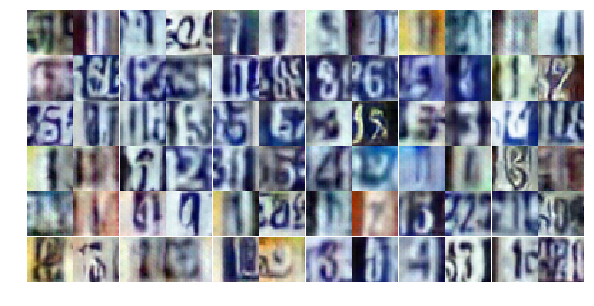

Epoch 14/20... Discriminator Loss: 1.0640... Generator Loss: 0.9955
Epoch 14/20... Discriminator Loss: 1.2331... Generator Loss: 0.5004
Epoch 14/20... Discriminator Loss: 0.5703... Generator Loss: 1.3181
Epoch 14/20... Discriminator Loss: 1.9297... Generator Loss: 0.2425
Epoch 14/20... Discriminator Loss: 0.8381... Generator Loss: 1.1469
Epoch 14/20... Discriminator Loss: 0.8704... Generator Loss: 0.9403
Epoch 14/20... Discriminator Loss: 1.1148... Generator Loss: 1.3524
Epoch 14/20... Discriminator Loss: 0.8070... Generator Loss: 1.1580
Epoch 14/20... Discriminator Loss: 1.2974... Generator Loss: 0.4497
Epoch 14/20... Discriminator Loss: 1.0624... Generator Loss: 0.6211


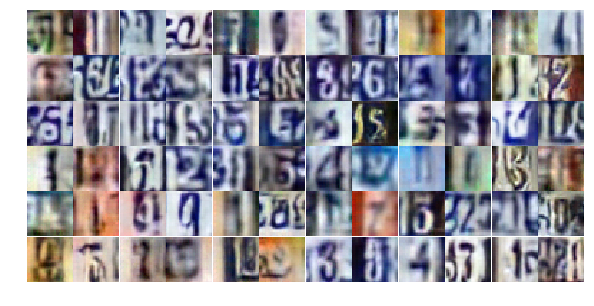

Epoch 14/20... Discriminator Loss: 0.6653... Generator Loss: 1.2218
Epoch 14/20... Discriminator Loss: 1.5275... Generator Loss: 0.4160
Epoch 15/20... Discriminator Loss: 0.9175... Generator Loss: 0.7528
Epoch 15/20... Discriminator Loss: 0.4209... Generator Loss: 1.9716
Epoch 15/20... Discriminator Loss: 1.1257... Generator Loss: 0.7170
Epoch 15/20... Discriminator Loss: 1.4478... Generator Loss: 0.4523
Epoch 15/20... Discriminator Loss: 0.9182... Generator Loss: 0.7713
Epoch 15/20... Discriminator Loss: 0.7753... Generator Loss: 1.1238
Epoch 15/20... Discriminator Loss: 0.9583... Generator Loss: 0.8269
Epoch 15/20... Discriminator Loss: 1.1086... Generator Loss: 0.5736


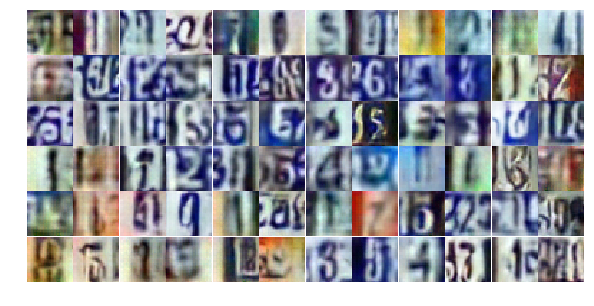

Epoch 15/20... Discriminator Loss: 2.1796... Generator Loss: 0.1791
Epoch 15/20... Discriminator Loss: 1.1610... Generator Loss: 0.5844
Epoch 15/20... Discriminator Loss: 1.3005... Generator Loss: 0.4737
Epoch 15/20... Discriminator Loss: 0.7642... Generator Loss: 0.9655
Epoch 15/20... Discriminator Loss: 1.1359... Generator Loss: 0.5986
Epoch 15/20... Discriminator Loss: 1.0562... Generator Loss: 0.6589
Epoch 15/20... Discriminator Loss: 1.3796... Generator Loss: 0.4163
Epoch 15/20... Discriminator Loss: 1.1408... Generator Loss: 0.6947
Epoch 15/20... Discriminator Loss: 0.8492... Generator Loss: 1.9656
Epoch 15/20... Discriminator Loss: 1.5465... Generator Loss: 0.4182


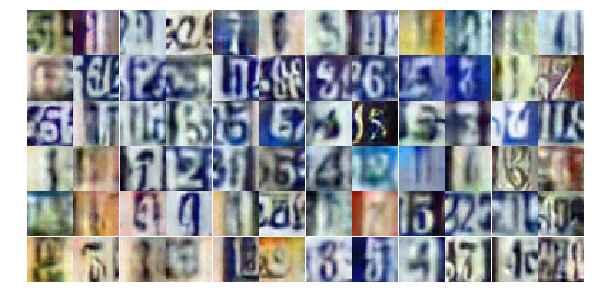

Epoch 15/20... Discriminator Loss: 1.4645... Generator Loss: 0.4988
Epoch 15/20... Discriminator Loss: 0.7583... Generator Loss: 1.0466
Epoch 15/20... Discriminator Loss: 0.5962... Generator Loss: 1.2154
Epoch 15/20... Discriminator Loss: 1.7221... Generator Loss: 0.2757
Epoch 15/20... Discriminator Loss: 1.6709... Generator Loss: 0.3500
Epoch 15/20... Discriminator Loss: 0.4534... Generator Loss: 1.5706
Epoch 15/20... Discriminator Loss: 1.2187... Generator Loss: 0.6012
Epoch 15/20... Discriminator Loss: 1.1697... Generator Loss: 0.5322
Epoch 15/20... Discriminator Loss: 1.0540... Generator Loss: 2.0863
Epoch 15/20... Discriminator Loss: 1.6496... Generator Loss: 0.3881


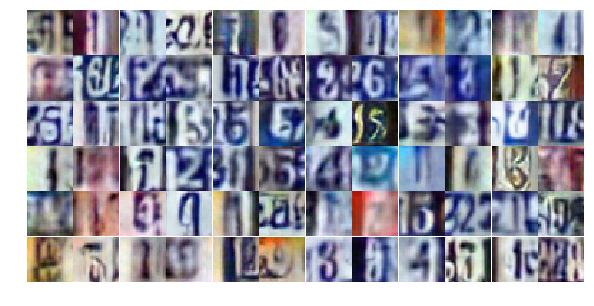

Epoch 15/20... Discriminator Loss: 0.7477... Generator Loss: 1.0985
Epoch 15/20... Discriminator Loss: 1.0300... Generator Loss: 0.7308
Epoch 15/20... Discriminator Loss: 0.5142... Generator Loss: 1.5054
Epoch 15/20... Discriminator Loss: 0.7956... Generator Loss: 1.1142
Epoch 15/20... Discriminator Loss: 0.3784... Generator Loss: 3.0797
Epoch 15/20... Discriminator Loss: 0.6591... Generator Loss: 1.6387
Epoch 15/20... Discriminator Loss: 0.5903... Generator Loss: 1.0993
Epoch 15/20... Discriminator Loss: 0.8587... Generator Loss: 4.1330
Epoch 15/20... Discriminator Loss: 0.3801... Generator Loss: 1.7556
Epoch 15/20... Discriminator Loss: 0.9783... Generator Loss: 0.7017


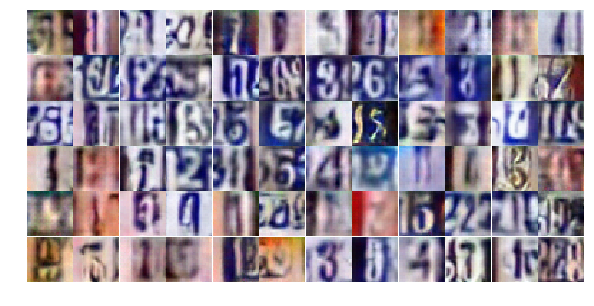

Epoch 15/20... Discriminator Loss: 0.6097... Generator Loss: 1.0954
Epoch 15/20... Discriminator Loss: 0.9128... Generator Loss: 0.7577
Epoch 15/20... Discriminator Loss: 0.3065... Generator Loss: 1.9506
Epoch 15/20... Discriminator Loss: 0.2018... Generator Loss: 2.6586
Epoch 15/20... Discriminator Loss: 0.4057... Generator Loss: 1.5957
Epoch 15/20... Discriminator Loss: 1.6621... Generator Loss: 0.2970
Epoch 15/20... Discriminator Loss: 1.0278... Generator Loss: 3.4278
Epoch 15/20... Discriminator Loss: 0.8927... Generator Loss: 2.4529
Epoch 15/20... Discriminator Loss: 0.7622... Generator Loss: 0.9554
Epoch 15/20... Discriminator Loss: 0.5687... Generator Loss: 1.9776


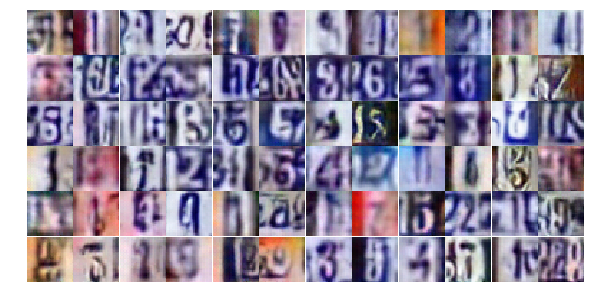

Epoch 15/20... Discriminator Loss: 0.8729... Generator Loss: 0.8090
Epoch 15/20... Discriminator Loss: 0.7883... Generator Loss: 0.9004
Epoch 15/20... Discriminator Loss: 0.4053... Generator Loss: 1.5759
Epoch 15/20... Discriminator Loss: 1.0972... Generator Loss: 0.6456
Epoch 15/20... Discriminator Loss: 0.1280... Generator Loss: 3.2483
Epoch 15/20... Discriminator Loss: 0.6236... Generator Loss: 3.7363
Epoch 15/20... Discriminator Loss: 1.3715... Generator Loss: 0.4016
Epoch 15/20... Discriminator Loss: 0.3049... Generator Loss: 2.0057
Epoch 15/20... Discriminator Loss: 0.6448... Generator Loss: 1.0108
Epoch 16/20... Discriminator Loss: 0.8174... Generator Loss: 0.8537


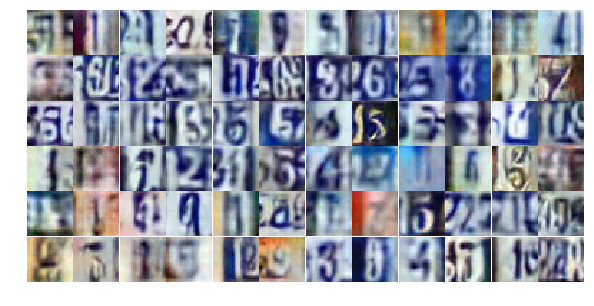

Epoch 16/20... Discriminator Loss: 0.3167... Generator Loss: 2.1215
Epoch 16/20... Discriminator Loss: 0.4625... Generator Loss: 1.3971
Epoch 16/20... Discriminator Loss: 1.6907... Generator Loss: 0.3262
Epoch 16/20... Discriminator Loss: 3.1089... Generator Loss: 0.1313
Epoch 16/20... Discriminator Loss: 1.1980... Generator Loss: 2.4290
Epoch 16/20... Discriminator Loss: 1.5503... Generator Loss: 0.5006
Epoch 16/20... Discriminator Loss: 1.7649... Generator Loss: 0.3343
Epoch 16/20... Discriminator Loss: 1.2332... Generator Loss: 0.5134
Epoch 16/20... Discriminator Loss: 0.8996... Generator Loss: 0.7589
Epoch 16/20... Discriminator Loss: 0.4590... Generator Loss: 2.6984


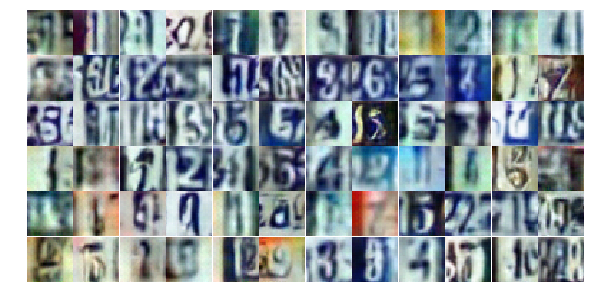

Epoch 16/20... Discriminator Loss: 1.6648... Generator Loss: 0.3168
Epoch 16/20... Discriminator Loss: 1.1342... Generator Loss: 0.8681
Epoch 16/20... Discriminator Loss: 1.0589... Generator Loss: 0.8723
Epoch 16/20... Discriminator Loss: 2.2373... Generator Loss: 0.2315
Epoch 16/20... Discriminator Loss: 0.9355... Generator Loss: 0.9118
Epoch 16/20... Discriminator Loss: 0.7555... Generator Loss: 1.0460
Epoch 16/20... Discriminator Loss: 2.0622... Generator Loss: 0.2497
Epoch 16/20... Discriminator Loss: 1.0879... Generator Loss: 1.0308
Epoch 16/20... Discriminator Loss: 0.5114... Generator Loss: 1.5300
Epoch 16/20... Discriminator Loss: 0.6312... Generator Loss: 1.3569


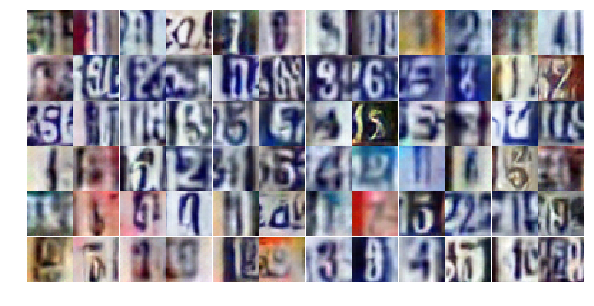

Epoch 16/20... Discriminator Loss: 1.4007... Generator Loss: 0.4951
Epoch 16/20... Discriminator Loss: 0.7361... Generator Loss: 2.3677
Epoch 16/20... Discriminator Loss: 0.8660... Generator Loss: 0.9621
Epoch 16/20... Discriminator Loss: 1.0552... Generator Loss: 0.6766
Epoch 16/20... Discriminator Loss: 0.9680... Generator Loss: 0.7409
Epoch 16/20... Discriminator Loss: 1.3251... Generator Loss: 0.4943
Epoch 16/20... Discriminator Loss: 1.3114... Generator Loss: 0.5040
Epoch 16/20... Discriminator Loss: 0.9604... Generator Loss: 0.8084
Epoch 16/20... Discriminator Loss: 1.2024... Generator Loss: 0.7115
Epoch 16/20... Discriminator Loss: 1.2106... Generator Loss: 0.5624


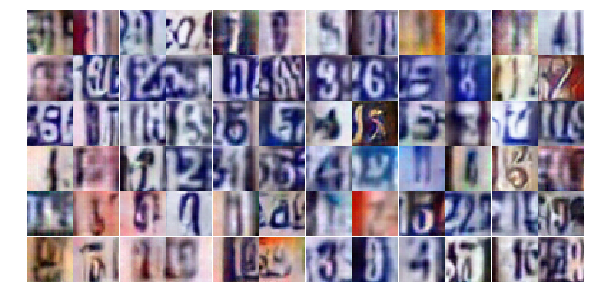

Epoch 16/20... Discriminator Loss: 0.8073... Generator Loss: 0.9414
Epoch 16/20... Discriminator Loss: 0.8722... Generator Loss: 1.2304
Epoch 16/20... Discriminator Loss: 0.7195... Generator Loss: 1.1101
Epoch 16/20... Discriminator Loss: 1.0980... Generator Loss: 0.8368
Epoch 16/20... Discriminator Loss: 1.0751... Generator Loss: 0.8706
Epoch 16/20... Discriminator Loss: 0.8529... Generator Loss: 2.0031
Epoch 16/20... Discriminator Loss: 1.1927... Generator Loss: 0.6092
Epoch 16/20... Discriminator Loss: 1.0273... Generator Loss: 0.7773
Epoch 16/20... Discriminator Loss: 0.7802... Generator Loss: 0.9194
Epoch 16/20... Discriminator Loss: 0.7207... Generator Loss: 1.2823


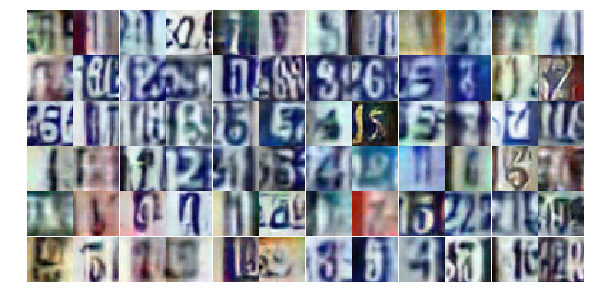

Epoch 16/20... Discriminator Loss: 0.7017... Generator Loss: 1.0449
Epoch 16/20... Discriminator Loss: 1.4112... Generator Loss: 0.5108
Epoch 16/20... Discriminator Loss: 1.7422... Generator Loss: 0.3690
Epoch 16/20... Discriminator Loss: 1.6943... Generator Loss: 0.5134
Epoch 16/20... Discriminator Loss: 1.0347... Generator Loss: 0.6762
Epoch 16/20... Discriminator Loss: 1.4752... Generator Loss: 0.3874
Epoch 16/20... Discriminator Loss: 0.7502... Generator Loss: 1.5319
Epoch 16/20... Discriminator Loss: 0.9528... Generator Loss: 0.8548
Epoch 16/20... Discriminator Loss: 0.7336... Generator Loss: 1.0424
Epoch 16/20... Discriminator Loss: 1.1340... Generator Loss: 0.7052


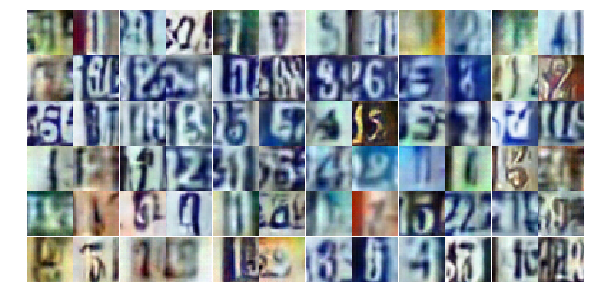

Epoch 16/20... Discriminator Loss: 1.4288... Generator Loss: 0.4967
Epoch 16/20... Discriminator Loss: 1.0818... Generator Loss: 0.6925
Epoch 16/20... Discriminator Loss: 1.4884... Generator Loss: 0.4171
Epoch 16/20... Discriminator Loss: 0.9670... Generator Loss: 1.3262
Epoch 16/20... Discriminator Loss: 0.7785... Generator Loss: 1.0363
Epoch 16/20... Discriminator Loss: 0.8154... Generator Loss: 0.9805
Epoch 17/20... Discriminator Loss: 0.9540... Generator Loss: 0.7421
Epoch 17/20... Discriminator Loss: 1.1119... Generator Loss: 0.6419
Epoch 17/20... Discriminator Loss: 0.8254... Generator Loss: 1.0952
Epoch 17/20... Discriminator Loss: 0.9666... Generator Loss: 0.8503


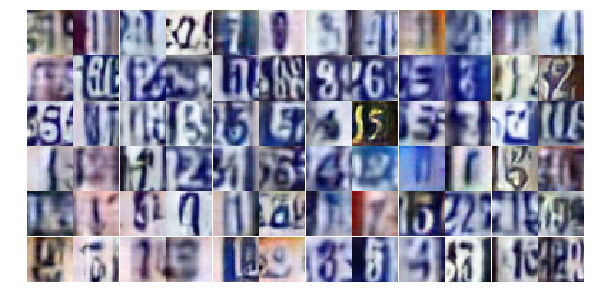

Epoch 17/20... Discriminator Loss: 0.8272... Generator Loss: 0.9323
Epoch 17/20... Discriminator Loss: 0.8391... Generator Loss: 0.8815
Epoch 17/20... Discriminator Loss: 1.0415... Generator Loss: 0.7816
Epoch 17/20... Discriminator Loss: 1.0849... Generator Loss: 0.7244
Epoch 17/20... Discriminator Loss: 1.7828... Generator Loss: 0.3293
Epoch 17/20... Discriminator Loss: 1.4102... Generator Loss: 0.4691
Epoch 17/20... Discriminator Loss: 0.6924... Generator Loss: 1.2353
Epoch 17/20... Discriminator Loss: 0.5986... Generator Loss: 1.2110
Epoch 17/20... Discriminator Loss: 0.6302... Generator Loss: 1.2207
Epoch 17/20... Discriminator Loss: 0.7898... Generator Loss: 1.1106


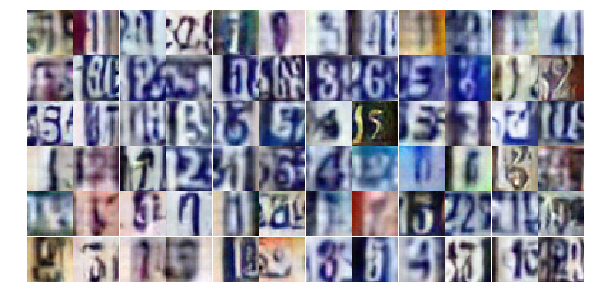

Epoch 17/20... Discriminator Loss: 0.8558... Generator Loss: 1.8877
Epoch 17/20... Discriminator Loss: 0.7089... Generator Loss: 1.2258
Epoch 17/20... Discriminator Loss: 0.6287... Generator Loss: 1.3361
Epoch 17/20... Discriminator Loss: 1.5288... Generator Loss: 0.3799
Epoch 17/20... Discriminator Loss: 0.7683... Generator Loss: 1.2791
Epoch 17/20... Discriminator Loss: 1.3756... Generator Loss: 0.5130
Epoch 17/20... Discriminator Loss: 0.6713... Generator Loss: 1.2137
Epoch 17/20... Discriminator Loss: 0.9241... Generator Loss: 0.7406
Epoch 17/20... Discriminator Loss: 1.2095... Generator Loss: 1.8425
Epoch 17/20... Discriminator Loss: 0.5512... Generator Loss: 2.2395


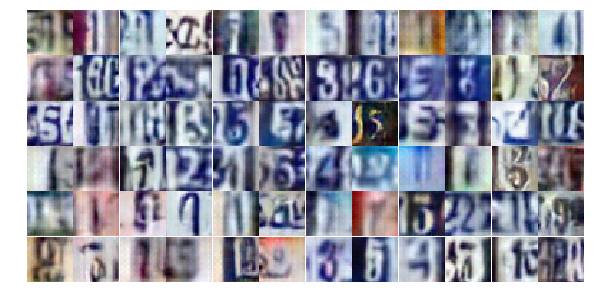

Epoch 17/20... Discriminator Loss: 2.0135... Generator Loss: 0.2901
Epoch 17/20... Discriminator Loss: 0.9092... Generator Loss: 0.9129
Epoch 17/20... Discriminator Loss: 0.5585... Generator Loss: 1.4967
Epoch 17/20... Discriminator Loss: 1.5565... Generator Loss: 0.3920
Epoch 17/20... Discriminator Loss: 2.0207... Generator Loss: 0.2234
Epoch 17/20... Discriminator Loss: 0.9038... Generator Loss: 0.8112
Epoch 17/20... Discriminator Loss: 1.0277... Generator Loss: 0.6809
Epoch 17/20... Discriminator Loss: 1.2883... Generator Loss: 0.5279
Epoch 17/20... Discriminator Loss: 1.2556... Generator Loss: 0.5326
Epoch 17/20... Discriminator Loss: 0.3201... Generator Loss: 2.4780


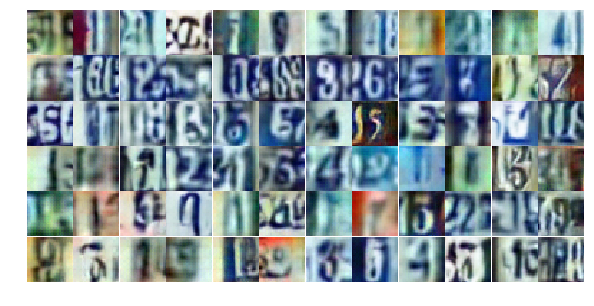

Epoch 17/20... Discriminator Loss: 0.6319... Generator Loss: 1.3899
Epoch 17/20... Discriminator Loss: 0.7247... Generator Loss: 1.5230
Epoch 17/20... Discriminator Loss: 0.6242... Generator Loss: 2.2108
Epoch 17/20... Discriminator Loss: 0.8535... Generator Loss: 1.1382
Epoch 17/20... Discriminator Loss: 1.8972... Generator Loss: 3.8215
Epoch 17/20... Discriminator Loss: 1.4293... Generator Loss: 1.6626
Epoch 17/20... Discriminator Loss: 0.6328... Generator Loss: 1.2228
Epoch 17/20... Discriminator Loss: 0.5435... Generator Loss: 1.9249
Epoch 17/20... Discriminator Loss: 0.3335... Generator Loss: 2.0899
Epoch 17/20... Discriminator Loss: 1.1016... Generator Loss: 0.7310


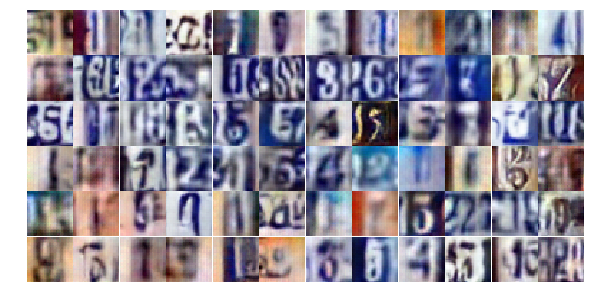

Epoch 17/20... Discriminator Loss: 1.3372... Generator Loss: 0.6754
Epoch 17/20... Discriminator Loss: 0.6093... Generator Loss: 1.5168
Epoch 17/20... Discriminator Loss: 1.2671... Generator Loss: 0.6213
Epoch 17/20... Discriminator Loss: 0.6185... Generator Loss: 1.6131
Epoch 17/20... Discriminator Loss: 0.8462... Generator Loss: 0.8472
Epoch 17/20... Discriminator Loss: 0.9204... Generator Loss: 0.8769
Epoch 17/20... Discriminator Loss: 0.8441... Generator Loss: 0.8670
Epoch 17/20... Discriminator Loss: 0.6566... Generator Loss: 1.1559
Epoch 17/20... Discriminator Loss: 3.9808... Generator Loss: 0.0570
Epoch 17/20... Discriminator Loss: 2.4424... Generator Loss: 2.1260


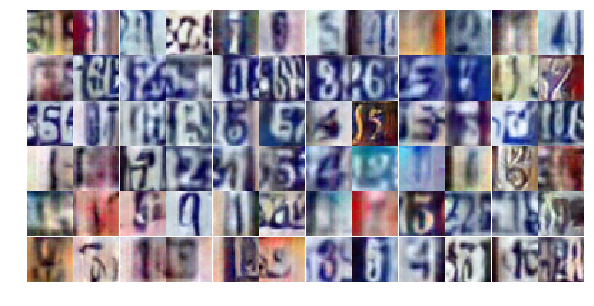

Epoch 17/20... Discriminator Loss: 1.3943... Generator Loss: 0.4710
Epoch 17/20... Discriminator Loss: 0.8975... Generator Loss: 1.1354
Epoch 17/20... Discriminator Loss: 0.7421... Generator Loss: 1.0903
Epoch 17/20... Discriminator Loss: 0.9430... Generator Loss: 1.0629
Epoch 18/20... Discriminator Loss: 1.0123... Generator Loss: 0.7649
Epoch 18/20... Discriminator Loss: 1.2361... Generator Loss: 0.5309
Epoch 18/20... Discriminator Loss: 1.0877... Generator Loss: 0.6112
Epoch 18/20... Discriminator Loss: 0.7068... Generator Loss: 1.4794
Epoch 18/20... Discriminator Loss: 1.4843... Generator Loss: 0.4986
Epoch 18/20... Discriminator Loss: 0.8922... Generator Loss: 0.9877


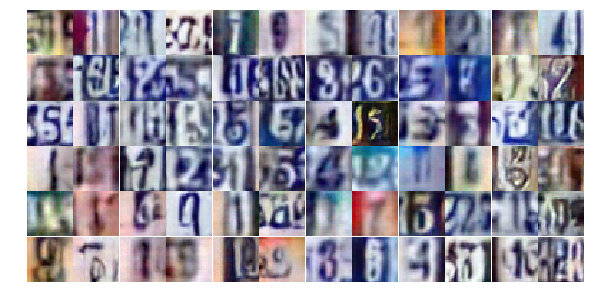

Epoch 18/20... Discriminator Loss: 0.6691... Generator Loss: 1.3055
Epoch 18/20... Discriminator Loss: 0.8700... Generator Loss: 2.0424
Epoch 18/20... Discriminator Loss: 0.9349... Generator Loss: 0.8506
Epoch 18/20... Discriminator Loss: 0.4859... Generator Loss: 1.9629
Epoch 18/20... Discriminator Loss: 0.7235... Generator Loss: 1.4907
Epoch 18/20... Discriminator Loss: 1.1114... Generator Loss: 0.6342
Epoch 18/20... Discriminator Loss: 0.6224... Generator Loss: 1.0948
Epoch 18/20... Discriminator Loss: 1.0878... Generator Loss: 0.7238
Epoch 18/20... Discriminator Loss: 0.6361... Generator Loss: 1.4146
Epoch 18/20... Discriminator Loss: 0.3321... Generator Loss: 1.9130


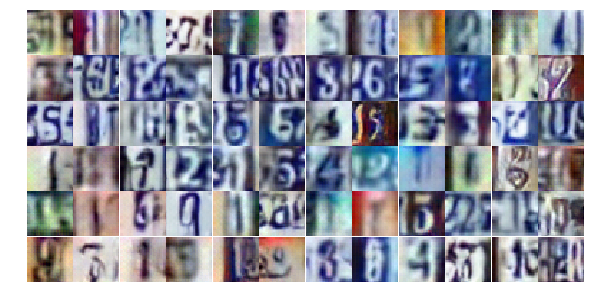

Epoch 18/20... Discriminator Loss: 0.7286... Generator Loss: 1.2980
Epoch 18/20... Discriminator Loss: 0.8521... Generator Loss: 1.1235
Epoch 18/20... Discriminator Loss: 0.9745... Generator Loss: 0.7660
Epoch 18/20... Discriminator Loss: 0.6185... Generator Loss: 1.2305
Epoch 18/20... Discriminator Loss: 1.1624... Generator Loss: 0.6000
Epoch 18/20... Discriminator Loss: 1.2054... Generator Loss: 1.7760
Epoch 18/20... Discriminator Loss: 1.3062... Generator Loss: 0.7512
Epoch 18/20... Discriminator Loss: 1.0951... Generator Loss: 0.6888
Epoch 18/20... Discriminator Loss: 0.7518... Generator Loss: 1.3674
Epoch 18/20... Discriminator Loss: 0.5017... Generator Loss: 1.4872


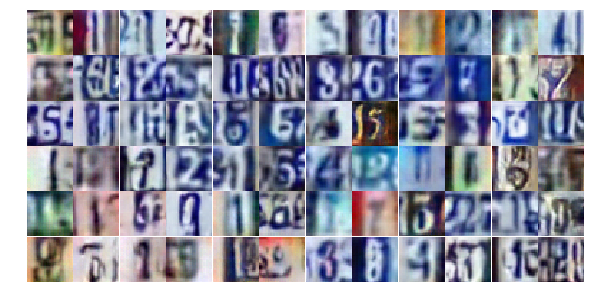

Epoch 18/20... Discriminator Loss: 0.4474... Generator Loss: 1.6614
Epoch 18/20... Discriminator Loss: 0.9969... Generator Loss: 0.7499
Epoch 18/20... Discriminator Loss: 1.3410... Generator Loss: 0.4581
Epoch 18/20... Discriminator Loss: 0.7722... Generator Loss: 0.9159
Epoch 18/20... Discriminator Loss: 0.7792... Generator Loss: 0.9729
Epoch 18/20... Discriminator Loss: 0.6469... Generator Loss: 1.2390
Epoch 18/20... Discriminator Loss: 0.5022... Generator Loss: 1.3880
Epoch 18/20... Discriminator Loss: 0.2520... Generator Loss: 3.0922
Epoch 18/20... Discriminator Loss: 1.1209... Generator Loss: 0.6568
Epoch 18/20... Discriminator Loss: 0.6479... Generator Loss: 1.2256


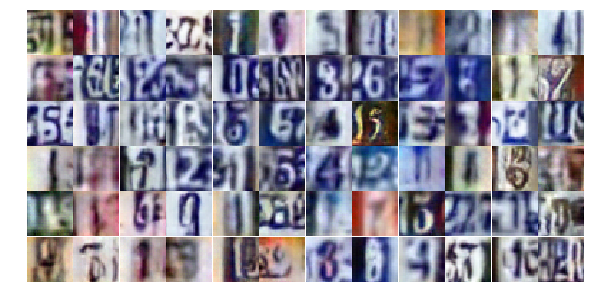

Epoch 18/20... Discriminator Loss: 0.5776... Generator Loss: 1.2830
Epoch 18/20... Discriminator Loss: 0.3050... Generator Loss: 1.9514
Epoch 18/20... Discriminator Loss: 0.9612... Generator Loss: 0.7855
Epoch 18/20... Discriminator Loss: 0.5042... Generator Loss: 1.4099
Epoch 18/20... Discriminator Loss: 0.8728... Generator Loss: 0.9036
Epoch 18/20... Discriminator Loss: 0.3690... Generator Loss: 1.6276
Epoch 18/20... Discriminator Loss: 1.1619... Generator Loss: 0.6180
Epoch 18/20... Discriminator Loss: 3.6539... Generator Loss: 5.4923
Epoch 18/20... Discriminator Loss: 0.7532... Generator Loss: 1.4716
Epoch 18/20... Discriminator Loss: 1.2153... Generator Loss: 0.6119


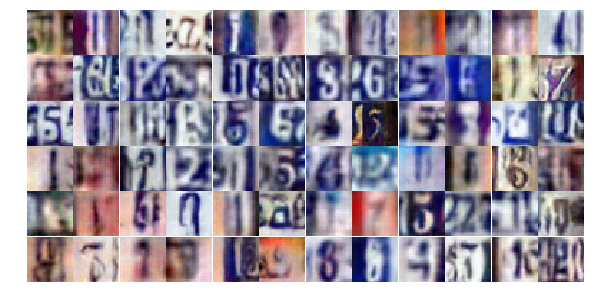

Epoch 18/20... Discriminator Loss: 1.0988... Generator Loss: 0.7682
Epoch 18/20... Discriminator Loss: 1.1398... Generator Loss: 0.6875
Epoch 18/20... Discriminator Loss: 0.8432... Generator Loss: 0.8198
Epoch 18/20... Discriminator Loss: 1.6474... Generator Loss: 4.9378
Epoch 18/20... Discriminator Loss: 1.8709... Generator Loss: 0.3065
Epoch 18/20... Discriminator Loss: 0.4838... Generator Loss: 4.0793
Epoch 18/20... Discriminator Loss: 0.7937... Generator Loss: 1.8568
Epoch 18/20... Discriminator Loss: 0.4922... Generator Loss: 1.8934
Epoch 18/20... Discriminator Loss: 0.9765... Generator Loss: 0.7270
Epoch 18/20... Discriminator Loss: 0.6110... Generator Loss: 1.1182


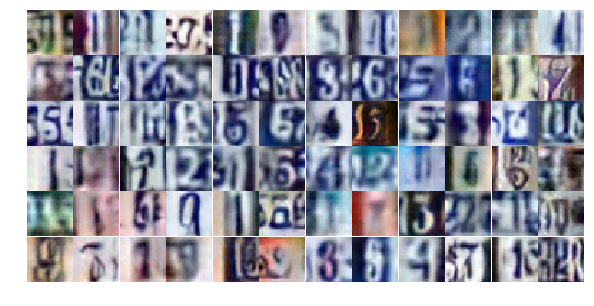

Epoch 18/20... Discriminator Loss: 0.4908... Generator Loss: 1.6512
Epoch 19/20... Discriminator Loss: 0.3814... Generator Loss: 2.3740
Epoch 19/20... Discriminator Loss: 0.3845... Generator Loss: 1.7386
Epoch 19/20... Discriminator Loss: 0.6926... Generator Loss: 1.0670
Epoch 19/20... Discriminator Loss: 0.4229... Generator Loss: 5.1144
Epoch 19/20... Discriminator Loss: 1.0985... Generator Loss: 0.6228
Epoch 19/20... Discriminator Loss: 0.8891... Generator Loss: 0.8860
Epoch 19/20... Discriminator Loss: 0.5862... Generator Loss: 1.6269
Epoch 19/20... Discriminator Loss: 0.4158... Generator Loss: 3.4363
Epoch 19/20... Discriminator Loss: 0.5334... Generator Loss: 1.3131


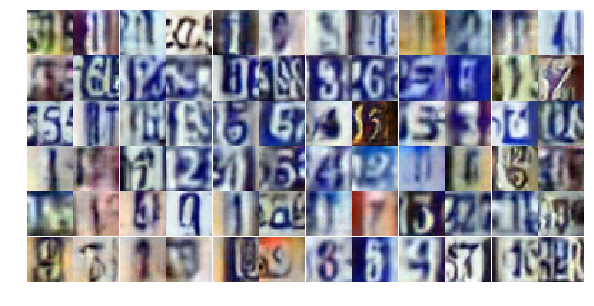

Epoch 19/20... Discriminator Loss: 0.7666... Generator Loss: 0.9376
Epoch 19/20... Discriminator Loss: 0.3396... Generator Loss: 1.8590
Epoch 19/20... Discriminator Loss: 0.9052... Generator Loss: 0.7971
Epoch 19/20... Discriminator Loss: 0.4854... Generator Loss: 1.4922
Epoch 19/20... Discriminator Loss: 0.8269... Generator Loss: 0.8201
Epoch 19/20... Discriminator Loss: 2.9865... Generator Loss: 4.1935
Epoch 19/20... Discriminator Loss: 1.2662... Generator Loss: 0.5613
Epoch 19/20... Discriminator Loss: 0.7967... Generator Loss: 0.9225
Epoch 19/20... Discriminator Loss: 0.8687... Generator Loss: 1.3009
Epoch 19/20... Discriminator Loss: 1.4280... Generator Loss: 0.4473


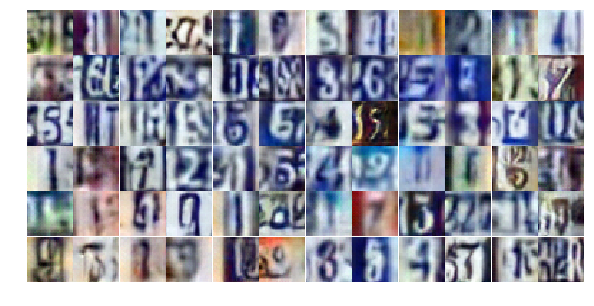

Epoch 19/20... Discriminator Loss: 0.3720... Generator Loss: 1.9197
Epoch 19/20... Discriminator Loss: 0.6092... Generator Loss: 1.1469
Epoch 19/20... Discriminator Loss: 0.6616... Generator Loss: 1.1512
Epoch 19/20... Discriminator Loss: 0.2349... Generator Loss: 2.2975
Epoch 19/20... Discriminator Loss: 0.3624... Generator Loss: 1.7381
Epoch 19/20... Discriminator Loss: 2.3635... Generator Loss: 0.1758
Epoch 19/20... Discriminator Loss: 1.2568... Generator Loss: 0.5758
Epoch 19/20... Discriminator Loss: 0.6233... Generator Loss: 2.4851
Epoch 19/20... Discriminator Loss: 0.8534... Generator Loss: 0.8957
Epoch 19/20... Discriminator Loss: 1.3926... Generator Loss: 0.5981


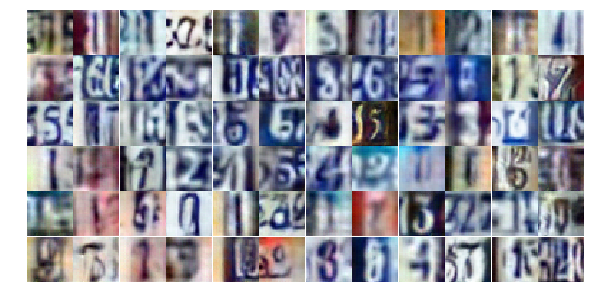

Epoch 19/20... Discriminator Loss: 0.9348... Generator Loss: 1.2509
Epoch 19/20... Discriminator Loss: 0.5280... Generator Loss: 1.3348
Epoch 19/20... Discriminator Loss: 0.5641... Generator Loss: 1.3688
Epoch 19/20... Discriminator Loss: 0.8570... Generator Loss: 0.9052
Epoch 19/20... Discriminator Loss: 0.5326... Generator Loss: 1.6615
Epoch 19/20... Discriminator Loss: 2.5750... Generator Loss: 0.1728
Epoch 19/20... Discriminator Loss: 2.9690... Generator Loss: 0.1431
Epoch 19/20... Discriminator Loss: 2.3834... Generator Loss: 0.9046
Epoch 19/20... Discriminator Loss: 1.9833... Generator Loss: 0.6093
Epoch 19/20... Discriminator Loss: 1.9216... Generator Loss: 0.7774


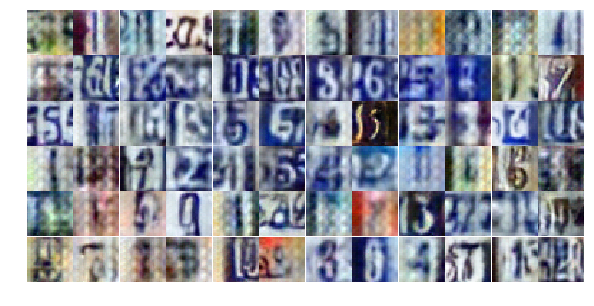

Epoch 19/20... Discriminator Loss: 1.5988... Generator Loss: 1.2596
Epoch 19/20... Discriminator Loss: 1.8606... Generator Loss: 0.6115
Epoch 19/20... Discriminator Loss: 1.4608... Generator Loss: 1.0627
Epoch 19/20... Discriminator Loss: 1.3042... Generator Loss: 0.8725
Epoch 19/20... Discriminator Loss: 1.6324... Generator Loss: 0.5624
Epoch 19/20... Discriminator Loss: 1.3030... Generator Loss: 1.1690
Epoch 19/20... Discriminator Loss: 1.1914... Generator Loss: 1.3269
Epoch 19/20... Discriminator Loss: 1.0047... Generator Loss: 1.3458
Epoch 19/20... Discriminator Loss: 0.6963... Generator Loss: 1.4316
Epoch 19/20... Discriminator Loss: 1.1066... Generator Loss: 0.7686


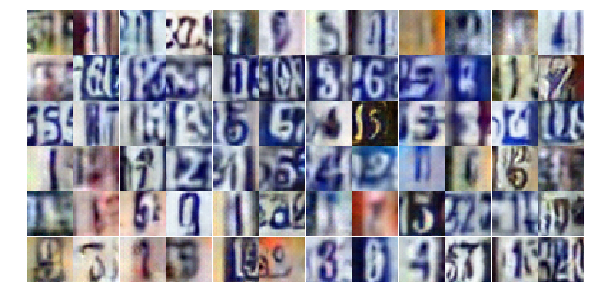

Epoch 19/20... Discriminator Loss: 1.0407... Generator Loss: 0.7493
Epoch 19/20... Discriminator Loss: 0.8708... Generator Loss: 0.9092
Epoch 19/20... Discriminator Loss: 1.3580... Generator Loss: 2.0973
Epoch 19/20... Discriminator Loss: 1.6682... Generator Loss: 0.2942
Epoch 19/20... Discriminator Loss: 1.2715... Generator Loss: 0.7019
Epoch 19/20... Discriminator Loss: 1.0537... Generator Loss: 1.5806
Epoch 19/20... Discriminator Loss: 1.4429... Generator Loss: 0.3725
Epoch 19/20... Discriminator Loss: 0.8227... Generator Loss: 1.1129
Epoch 20/20... Discriminator Loss: 1.1745... Generator Loss: 0.6632
Epoch 20/20... Discriminator Loss: 0.9933... Generator Loss: 0.7337


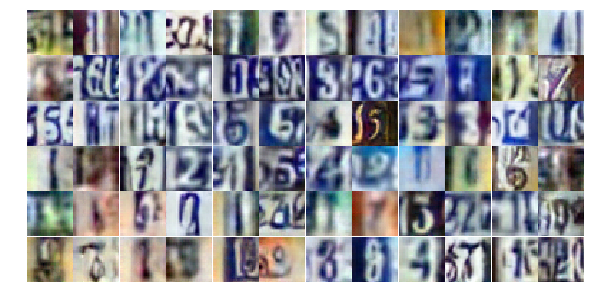

Epoch 20/20... Discriminator Loss: 0.6603... Generator Loss: 1.2719
Epoch 20/20... Discriminator Loss: 0.8349... Generator Loss: 1.1454
Epoch 20/20... Discriminator Loss: 1.5595... Generator Loss: 0.3539
Epoch 20/20... Discriminator Loss: 1.4706... Generator Loss: 0.4113
Epoch 20/20... Discriminator Loss: 1.2115... Generator Loss: 0.5602
Epoch 20/20... Discriminator Loss: 0.7266... Generator Loss: 1.1784
Epoch 20/20... Discriminator Loss: 0.6946... Generator Loss: 1.5418
Epoch 20/20... Discriminator Loss: 0.9112... Generator Loss: 1.2932
Epoch 20/20... Discriminator Loss: 1.2382... Generator Loss: 0.5772
Epoch 20/20... Discriminator Loss: 1.0019... Generator Loss: 0.6880


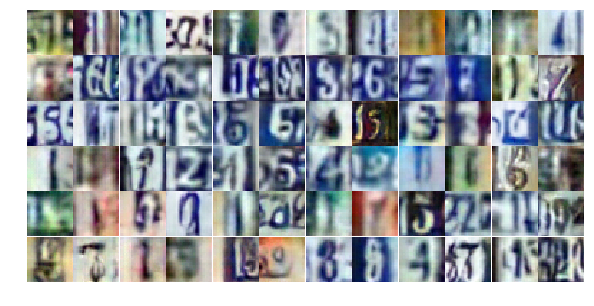

Epoch 20/20... Discriminator Loss: 1.7610... Generator Loss: 0.2634
Epoch 20/20... Discriminator Loss: 1.1346... Generator Loss: 0.7154
Epoch 20/20... Discriminator Loss: 1.0417... Generator Loss: 0.6804
Epoch 20/20... Discriminator Loss: 1.0544... Generator Loss: 0.9032
Epoch 20/20... Discriminator Loss: 1.2290... Generator Loss: 0.5673
Epoch 20/20... Discriminator Loss: 0.8692... Generator Loss: 0.8558
Epoch 20/20... Discriminator Loss: 1.0835... Generator Loss: 0.6761
Epoch 20/20... Discriminator Loss: 0.6734... Generator Loss: 1.1113
Epoch 20/20... Discriminator Loss: 0.4855... Generator Loss: 1.7086
Epoch 20/20... Discriminator Loss: 1.1965... Generator Loss: 0.6357


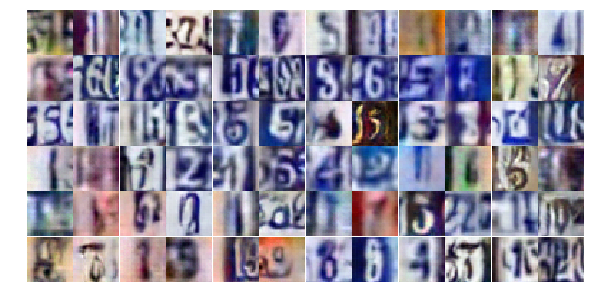

Epoch 20/20... Discriminator Loss: 0.7926... Generator Loss: 1.1043
Epoch 20/20... Discriminator Loss: 0.9328... Generator Loss: 0.8110
Epoch 20/20... Discriminator Loss: 0.4573... Generator Loss: 1.4279
Epoch 20/20... Discriminator Loss: 1.1514... Generator Loss: 0.6485
Epoch 20/20... Discriminator Loss: 0.8597... Generator Loss: 0.9404
Epoch 20/20... Discriminator Loss: 0.7279... Generator Loss: 1.3805
Epoch 20/20... Discriminator Loss: 0.7667... Generator Loss: 1.6499
Epoch 20/20... Discriminator Loss: 2.1971... Generator Loss: 0.1995
Epoch 20/20... Discriminator Loss: 1.2970... Generator Loss: 0.6765
Epoch 20/20... Discriminator Loss: 0.8199... Generator Loss: 0.9088


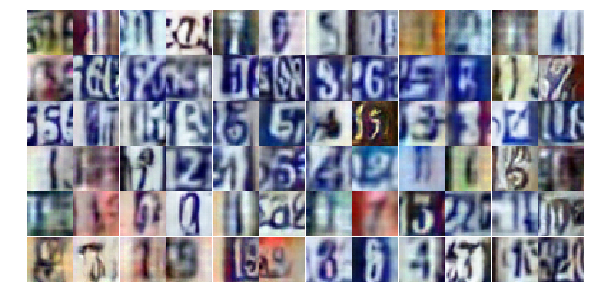

Epoch 20/20... Discriminator Loss: 0.7446... Generator Loss: 1.1543
Epoch 20/20... Discriminator Loss: 0.8565... Generator Loss: 0.8874
Epoch 20/20... Discriminator Loss: 1.5355... Generator Loss: 0.4499
Epoch 20/20... Discriminator Loss: 0.8715... Generator Loss: 1.0522
Epoch 20/20... Discriminator Loss: 1.0264... Generator Loss: 0.6827
Epoch 20/20... Discriminator Loss: 0.9898... Generator Loss: 1.3510
Epoch 20/20... Discriminator Loss: 0.9838... Generator Loss: 1.2338
Epoch 20/20... Discriminator Loss: 1.1924... Generator Loss: 0.6072
Epoch 20/20... Discriminator Loss: 1.3245... Generator Loss: 0.5214
Epoch 20/20... Discriminator Loss: 0.9846... Generator Loss: 0.7593


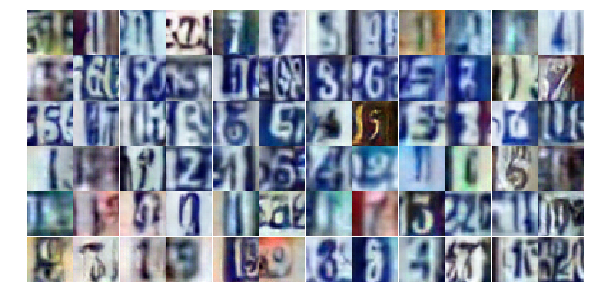

Epoch 20/20... Discriminator Loss: 1.1595... Generator Loss: 0.6086
Epoch 20/20... Discriminator Loss: 0.7260... Generator Loss: 1.2984
Epoch 20/20... Discriminator Loss: 1.4736... Generator Loss: 0.5195
Epoch 20/20... Discriminator Loss: 1.1073... Generator Loss: 0.6585
Epoch 20/20... Discriminator Loss: 0.7250... Generator Loss: 1.4142
Epoch 20/20... Discriminator Loss: 1.0784... Generator Loss: 0.6662
Epoch 20/20... Discriminator Loss: 1.5606... Generator Loss: 0.4023
Epoch 20/20... Discriminator Loss: 0.8936... Generator Loss: 1.0774
Epoch 20/20... Discriminator Loss: 0.6149... Generator Loss: 1.2130
Epoch 20/20... Discriminator Loss: 0.9738... Generator Loss: 0.8097


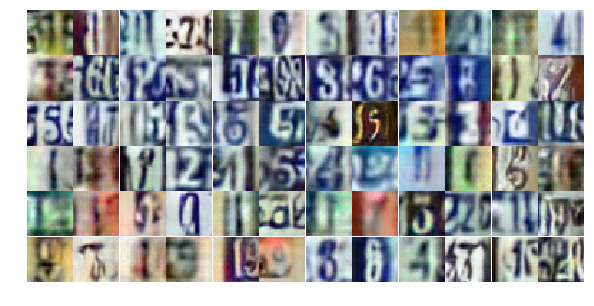

Epoch 20/20... Discriminator Loss: 0.4845... Generator Loss: 1.8122
Epoch 20/20... Discriminator Loss: 0.6232... Generator Loss: 1.5102
Epoch 20/20... Discriminator Loss: 0.6803... Generator Loss: 1.0985
Epoch 20/20... Discriminator Loss: 1.0928... Generator Loss: 0.9160
Epoch 20/20... Discriminator Loss: 0.6011... Generator Loss: 1.3430
Epoch 20/20... Discriminator Loss: 0.7825... Generator Loss: 0.9394


In [26]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

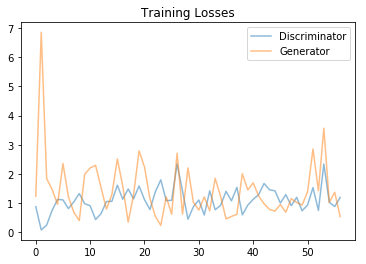

In [22]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

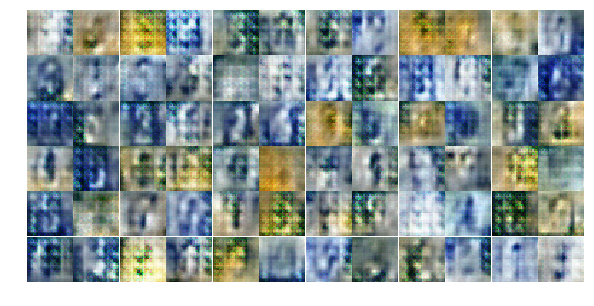

In [23]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))